# **Домашнее задание №1 (pro)**

В этом домашнем задании вам будет необходимо:
*  обучить модель регрессии для предсказания стоимости автомобилей;
* реализовать веб-сервис для применения построенной модели на новых данных

> Оценка за домашку = $min(\text{ваш балл}, 11)$

**Мягкий дедлайн: 27 ноября 23:59**

**Жесткий дедлайн: 20 декабря 23:59 (конец модуля)**



**Примечание**

В каждой части оцениваются как код, **так и ответы на вопросы.** Вопросы подсвечены синим цветом.

Если нет одного и/или другого, то часть баллов за соответствующее задание снимается.

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import random
import seaborn as sns

random.seed(42)
np.random.seed(42)

In [ ]:
!pip install --upgrade pandas scikit-learn

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 89.9/89.9 kB 4.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.1/13.1 MB 80.8 MB/s eta 0:00:00
  Attempting uninstall: pandas
    Found existing installation: pandas 2.2.2
    Uninstalling pandas-2.2.2:
      Successfully uninstalled pandas-2.2.2
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
cudf-cu12 24.10.1 requires pandas<2.2.3dev0,>=2.0, but you have pandas 2.2.3 which is incompatible.
google-colab 1.0.0 requires pandas==2.2.2, but you have pandas 2.2.3 which is incompatible.


In [ ]:
pip install phik

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 686.1/686.1 kB 8.4 MB/s eta 0:00:00


In [ ]:
import phik
from phik import resources, report
from phik import phik_matrix

### **Задание 0**
Для чего фиксируем сиды в домашках?

При запуске ячейки еще раз компьютер отобразит те же псевдослучайные числа. Поэтому результаты будут воспроизводимыми.

# **Часть 1 | EDA**


Первая часть состоит из классических шагов EDA:

- Базовый EDA и обработка признаков (1.7 балла)
- Визуализации признаков и их анализ (1.6 балл)

Всего можно набрать 3.3 основных балла и 0.25 бонусных.

В следующих частях, вы увидите бонусные задания. Бонусные задания выделены как **Дополнительное задание/Бонус**. Вы можете выполнять их, чтобы в случае ошибок в основных задачах всё равно набрать за работу максимум. Кроме того, дополнительные задания позволяют вам углубить знания.

Призываем активно использовать их!

## **Простейший EDA и обработка признаков (1.7 балла)**

In [3]:
df_train = pd.read_csv('https://raw.githubusercontent.com/Murcha1990/MLDS_ML_2022/main/Hometasks/HT1/cars_train.csv')
df_test = pd.read_csv('https://raw.githubusercontent.com/Murcha1990/MLDS_ML_2022/main/Hometasks/HT1/cars_test.csv')

print("Train data shape:", df_train.shape)
print("Test data shape: ", df_test.shape)

Train data shape: (6999, 13)
Test data shape:  (1000, 13)


In [ ]:
df_train

,name,year,selling_price,km_driven,fuel,seller_type,transmission,owner,mileage,engine,max_power,torque,seats
0,Maruti Swift Dzire VDI,2014,450000,145500,Diesel,Individual,Manual,First Owner,23.4 kmpl,1248 CC,74 bhp,190Nm@ 2000rpm,5.0
1,Skoda Rapid 1.5 TDI Ambition,2014,370000,120000,Diesel,Individual,Manual,Second Owner,21.14 kmpl,1498 CC,103.52 bhp,250Nm@ 1500-2500rpm,5.0
2,Hyundai i20 Sportz Diesel,2010,225000,127000,Diesel,Individual,Manual,First Owner,23.0 kmpl,1396 CC,90 bhp,22.4 kgm at 1750-2750rpm,5.0
3,Maruti Swift VXI BSIII,2007,130000,120000,Petrol,Individual,Manual,First Owner,16.1 kmpl,1298 CC,88.2 bhp,"11.5@ 4,500(kgm@ rpm)",5.0
4,Hyundai Xcent 1.2 VTVT E Plus,2017,440000,45000,Petrol,Individual,Manual,First Owner,20.14 kmpl,1197 CC,81.86 bhp,113.75nm@ 4000rpm,5.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6994,Hyundai i20 Magna,2013,320000,110000,Petrol,Individual,Manual,First Owner,18.5 kmpl,1197 CC,82.85 bhp,113.7Nm@ 4000rpm,5.0
6995,Hyundai Verna CRDi SX,2007,135000,119000,Diesel,Individual,Manual,Fourth & Above Owner,16.8 kmpl,1493 CC,110 bhp,"24@ 1,900-2,750(kgm@ rpm)",5.0
6996,Maruti Swift Dzire ZDi,2009,382000,120000,Diesel,Individual,Manual,First Owner,19.3 kmpl,1248 CC,73.9 bhp,190Nm@ 2000rpm,5.0
6997,Tata Indigo CR4,2013,290000,25000,Diesel,Individual,Manual,First Owner,23.57 kmpl,1396 CC,70 bhp,140Nm@ 1800-3000rpm,5.0


### **Задание 1.(0.4 балла)**
Выполните операции, направленные на базовое исследование данных:

- [ ] Посмотрите, есть ли в датасете пропуски и дубликаты. Запишите/выведите названия колонок, для которых есть пропущенные значения (0.1 балла)
- [ ] Посмотрите, есть ли в данных явные дубликаты (0.05 балла)
- [ ] Постройте дашборд в одну строку, используя [ydata-profilling](https://github.com/ydataai/ydata-profiling)(0.15 балла)
- [ ] Опишите базовые выводы (какие — выберите сами), используя дашборд (0.2 балла)

In [ ]:
print(df_train.isnull().sum())

name               0
year               0
selling_price      0
km_driven          0
fuel               0
seller_type        0
transmission       0
owner              0
mileage          202
engine           202
max_power        196
torque           203
seats            202
dtype: int64


In [ ]:
print(df_test.isnull().sum())

name              0
year              0
selling_price     0
km_driven         0
fuel              0
seller_type       0
transmission      0
owner             0
mileage          19
engine           19
max_power        19
torque           19
seats            19
dtype: int64


In [ ]:
columns_with_duplicates = [col for col in df_train.columns if df_train[col].duplicated().any()]
columns_with_duplicates

['name',
 'year',
 'selling_price',
 'km_driven',
 'fuel',
 'seller_type',
 'transmission',
 'owner',
 'mileage',
 'engine',
 'max_power',
 'torque',
 'seats']

In [ ]:
columns_with_duplicates_test = [col for col in df_test.columns if df_test[col].duplicated().any()]
columns_with_duplicates_test

['name',
 'year',
 'selling_price',
 'km_driven',
 'fuel',
 'seller_type',
 'transmission',
 'owner',
 'mileage',
 'engine',
 'max_power',
 'torque',
 'seats']

In [ ]:
#!pip install ydata_profiling
from ydata_profiling import ProfileReport

In [ ]:
profile_report = ProfileReport(df_train)

In [ ]:
profile_report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Пропущенных значений очень много, почти 1000.
Где-то есть сильные корреляции, где-до поменьше, это свидетельствует о хорошем качестве данных.
Цена продажи машины почти не зависит от года выпуска.
В данном датасете пробег машины не скоррелирован с его ценой, что очень странно.

### **Задание 2 (0.2 балла)**
Проанализируйте статистики датасета.

**Ваша задача:**
- [ ] Посчитайте основные статистики по числовым столбцам для трейна и теста
- [ ] Посчитайте основные статистики по категориальным столбцам для трейна и теста
- [ ] Сравните среднее и медиану внутри `train`, внутри `test` и между собой. О чём могут говорить результаты?

**Подсказка:**

Используте ``.describe()`` с нужным(и) аргументом(-ами).

In [ ]:
df_train.describe()

,year,selling_price,km_driven,seats
count,6999.000000,6.999000e+03,6.999000e+03,6797.000000
mean,2013.818403,6.395152e+05,6.958462e+04,5.419008
std,4.053095,8.089419e+05,5.772400e+04,0.965767
min,1983.000000,2.999900e+04,1.000000e+00,2.000000
25%,2011.000000,2.549990e+05,3.500000e+04,5.000000
50%,2015.000000,4.500000e+05,6.000000e+04,5.000000
75%,2017.000000,6.750000e+05,9.700000e+04,5.000000
max,2020.000000,1.000000e+07,2.360457e+06,14.000000


In [ ]:
df_test.describe()

,year,selling_price,km_driven,seats
count,1000.000000,1.000000e+03,1000.000000,981.000000
mean,2013.681000,6.179010e+05,71393.341000,5.410805
std,4.012149,7.585539e+05,48486.218662,0.919985
min,1995.000000,3.100000e+04,1303.000000,4.000000
25%,2011.000000,2.500000e+05,37000.000000,5.000000
50%,2014.000000,4.349990e+05,61500.000000,5.000000
75%,2017.000000,6.700000e+05,100000.000000,5.000000
max,2020.000000,6.000000e+06,375000.000000,9.000000


In [ ]:
df_train.describe(include=['object'])

,name,fuel,seller_type,transmission,owner,mileage,engine,max_power,torque
count,6999,6999,6999,6999,6999,6797,6797,6803,6796
unique,1924,4,3,2,5,386,120,316,419
top,Maruti Swift Dzire VDI,Diesel,Individual,Manual,First Owner,18.9 kmpl,1248 CC,74 bhp,190Nm@ 2000rpm
freq,116,3793,5826,6095,4587,197,885,330,468


In [ ]:
df_test.describe(include=['object'])

,name,fuel,seller_type,transmission,owner,mileage,engine,max_power,torque
count,1000,1000,1000,1000,1000,981,981,981,981
unique,621,4,3,2,5,237,88,182,226
top,Maruti Alto 800 LXI,Diesel,Individual,Manual,First Owner,18.6 kmpl,1248 CC,74 bhp,200Nm@ 1750rpm
freq,15,534,837,877,623,23,116,43,57


Среднее и медиана сильно не отличаются. Это говорит о том, что данные симметричны, что хорошо

### **Задание 3 (0.2 балла)**

- [ ] Посмотрите, есть ли в трейне объекты с одинаковым признаковым описанием (целевую переменную следует исключить). Если есть, то сколько? (0.05 балла)
- [ ] Отобразите такие объекты (0.05 балла)
- [ ] Удалите повторяющиеся строки. Если при одинаковом признаковом описании цены на автомобили отличаются, то оставьте первую строку по этому автомобилю (0.05 балла)
- [ ]  Обновите индексы строк таким образом, чтобы они шли от 0 без пропусков (0.05 балла)

In [ ]:
features = df_train.drop(columns=['selling_price'])
duplicates = features.duplicated(keep=False)  # Учитываем все повторяющиеся строки
duplicate_count = duplicates.sum()
duplicate_count

1799

In [ ]:
duplicate_objects = df_train[duplicates]
duplicate_objects

,name,year,selling_price,km_driven,fuel,seller_type,transmission,owner,mileage,engine,max_power,torque,seats
22,Maruti Baleno Delta 1.2,2016,575000,45000,Petrol,Individual,Manual,First Owner,21.4 kmpl,1197 CC,83.1 bhp,115Nm@ 4000rpm,5.0
26,Maruti Omni E MPI STD BS IV,2018,254999,25000,Petrol,Individual,Manual,First Owner,16.8 kmpl,796 CC,34.2 bhp,59Nm@ 2500rpm,8.0
27,Maruti Vitara Brezza LDi Option,2017,670000,70000,Diesel,Individual,Manual,First Owner,24.3 kmpl,1248 CC,88.5 bhp,200Nm@ 1750rpm,5.0
28,Fiat Palio 1.2 ELX,2003,70000,50000,Petrol,Individual,Manual,Second Owner,NaN,NaN,NaN,NaN,NaN
29,Maruti Omni 8 Seater BSIV,2012,150000,35000,Petrol,Individual,Manual,Second Owner,14.0 kmpl,796 CC,35 bhp,6.1kgm@ 3000rpm,5.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6981,Ford Freestyle Titanium Plus Diesel BSIV,2018,750000,24000,Diesel,Individual,Manual,First Owner,24.4 kmpl,1498 CC,98.63 bhp,215Nm@ 1750-3000rpm,5.0
6984,Ford Freestyle Titanium Plus Diesel BSIV,2018,746000,24000,Diesel,Individual,Manual,First Owner,24.4 kmpl,1498 CC,98.63 bhp,215Nm@ 1750-3000rpm,5.0
6989,Maruti Swift Dzire VDI,2015,625000,50000,Diesel,Individual,Manual,First Owner,26.59 kmpl,1248 CC,74 bhp,190Nm@ 2000rpm,5.0
6997,Tata Indigo CR4,2013,290000,25000,Diesel,Individual,Manual,First Owner,23.57 kmpl,1396 CC,70 bhp,140Nm@ 1800-3000rpm,5.0


In [ ]:
df_train.drop_duplicates(inplace=True)

In [ ]:
df_train.shape

(6014, 13)

In [ ]:
df_train = df_train.drop_duplicates(subset=["name", "year", "km_driven", "fuel", "seller_type", "transmission", "owner", "mileage", "engine", "max_power", "torque", "seats"], keep="first")

In [ ]:
df_train.shape

(5840, 13)

In [ ]:
df_train.reset_index(drop=True, inplace=True)
df_train.head(100)

,name,year,selling_price,km_driven,fuel,seller_type,transmission,owner,mileage,engine,max_power,torque,seats
0,Maruti Swift Dzire VDI,2014,450000,145500,Diesel,Individual,Manual,First Owner,23.4 kmpl,1248 CC,74 bhp,190Nm@ 2000rpm,5.0
1,Skoda Rapid 1.5 TDI Ambition,2014,370000,120000,Diesel,Individual,Manual,Second Owner,21.14 kmpl,1498 CC,103.52 bhp,250Nm@ 1500-2500rpm,5.0
2,Hyundai i20 Sportz Diesel,2010,225000,127000,Diesel,Individual,Manual,First Owner,23.0 kmpl,1396 CC,90 bhp,22.4 kgm at 1750-2750rpm,5.0
3,Maruti Swift VXI BSIII,2007,130000,120000,Petrol,Individual,Manual,First Owner,16.1 kmpl,1298 CC,88.2 bhp,"11.5@ 4,500(kgm@ rpm)",5.0
4,Hyundai Xcent 1.2 VTVT E Plus,2017,440000,45000,Petrol,Individual,Manual,First Owner,20.14 kmpl,1197 CC,81.86 bhp,113.75nm@ 4000rpm,5.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,Mahindra Scorpio VLX AT AIRBAG BSIV,2014,625000,70000,Diesel,Individual,Automatic,Second Owner,11.79 kmpl,2179 CC,120 bhp,290Nm@ 1800-2800rpm,8.0
96,Ford Freestyle Titanium Petrol BSIV,2020,400000,5000,Petrol,Individual,Manual,Second Owner,19.0 kmpl,1194 CC,94.68 bhp,120Nm@ 4250rpm,5.0
97,Hyundai Verna VTVT 1.6 SX,2017,866000,37800,Petrol,Individual,Manual,First Owner,17.0 kmpl,1591 CC,121.3 bhp,151Nm@ 4850rpm,5.0
98,Volkswagen Passat 1.8 TSI MT,2010,700000,114000,Petrol,Individual,Manual,First Owner,14.3 kmpl,1798 CC,160 bhp,250Nm@ 1500~4500rpm,5.0


In [ ]:
assert df_train.shape == (5840, 13)

### **Задание 4 (0.3 балла)**

Вы могли заметить, что с признаками ``mileage, engine, max_power и torque`` всё не очень хорошо. Они распознаются как строки (можно убедиться в этом, вызвав `data.dtypes`). Однако эти переменные не являются категориальными — они — числа. Соответственно, нужно привести их к числовому виду.

**Задача :**
* [ ] Уберите единицы измерения для признаков ``mileage, engine, max_power``.
* [ ] Приведите тип данных к ``float``.
* [ ] Предобработайте признак `torque` — разделите его на два: собственно `torque` и `max_torque_rpm`. Учтите единицы измерения


**Важно**
- Все действия нужно производить над обоими датасетами — `train` и `test`.

Работаем со столбцами 'mileage', 'engine', 'max_power'

In [ ]:
 for i in range(5840):
  if isinstance(df_train.at[i, 'mileage'],float):
    pass
  elif ' km/kg' in df_train.at[i, 'mileage']:
      df_train.at[i, 'mileage'] = float(df_train.at[i, 'mileage'].replace(' km/kg', '')) * 0.5
  elif ' kmpl' in df_train.at[i, 'mileage']:
      df_train.at[i, 'mileage'] = float(df_train.at[i, 'mileage'].replace(' kmpl', ''))


In [ ]:
 for i in range(5840):
  if isinstance(df_train.at[i, 'engine'],float):
    pass
  elif ' CC' in df_train.at[i, 'engine']:
      df_train.at[i, 'engine'] = float(df_train.at[i, 'engine'].replace(' CC', ''))

In [ ]:
df_train

,name,year,selling_price,km_driven,fuel,seller_type,transmission,owner,mileage,engine,max_power,torque,seats
0,Maruti Swift Dzire VDI,2014,450000,145500,Diesel,Individual,Manual,First Owner,23.4,1248.0,74 bhp,190Nm@ 2000rpm,5.0
1,Skoda Rapid 1.5 TDI Ambition,2014,370000,120000,Diesel,Individual,Manual,Second Owner,21.14,1498.0,103.52 bhp,250Nm@ 1500-2500rpm,5.0
2,Hyundai i20 Sportz Diesel,2010,225000,127000,Diesel,Individual,Manual,First Owner,23.0,1396.0,90 bhp,22.4 kgm at 1750-2750rpm,5.0
3,Maruti Swift VXI BSIII,2007,130000,120000,Petrol,Individual,Manual,First Owner,16.1,1298.0,88.2 bhp,"11.5@ 4,500(kgm@ rpm)",5.0
4,Hyundai Xcent 1.2 VTVT E Plus,2017,440000,45000,Petrol,Individual,Manual,First Owner,20.14,1197.0,81.86 bhp,113.75nm@ 4000rpm,5.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
5835,Hyundai Santro Xing GLS,2008,120000,191000,Petrol,Individual,Manual,First Owner,17.92,1086.0,62.1 bhp,96.1Nm@ 3000rpm,5.0
5836,Maruti Wagon R VXI BS IV with ABS,2013,260000,50000,Petrol,Individual,Manual,Second Owner,18.9,998.0,67.1 bhp,90Nm@ 3500rpm,5.0
5837,Hyundai i20 Magna,2013,320000,110000,Petrol,Individual,Manual,First Owner,18.5,1197.0,82.85 bhp,113.7Nm@ 4000rpm,5.0
5838,Hyundai Verna CRDi SX,2007,135000,119000,Diesel,Individual,Manual,Fourth & Above Owner,16.8,1493.0,110 bhp,"24@ 1,900-2,750(kgm@ rpm)",5.0


In [ ]:
df_train.at[3586, 'max_power'] = 50.0


In [ ]:
 for i in range(5840):
  if isinstance(df_train.at[i, 'max_power'],float):
    pass
  elif ' bhp' in df_train.at[i, 'max_power']:
      df_train.at[i, 'max_power'] = float(df_train.at[i, 'max_power'].replace(' bhp', ''))

Работает со столбцом 'torque_copy'

In [ ]:
df_train['torque_copy'] = df_train['torque'].copy()

In [ ]:
df_train.head(10)

,name,year,selling_price,km_driven,fuel,seller_type,transmission,owner,mileage,engine,max_power,torque,seats,torque_copy
0,Maruti Swift Dzire VDI,2014,450000,145500,Diesel,Individual,Manual,First Owner,23.4,1248.0,74.0,190Nm@ 2000rpm,5.0,190Nm@ 2000rpm
1,Skoda Rapid 1.5 TDI Ambition,2014,370000,120000,Diesel,Individual,Manual,Second Owner,21.14,1498.0,103.52,250Nm@ 1500-2500rpm,5.0,250Nm@ 1500-2500rpm
2,Hyundai i20 Sportz Diesel,2010,225000,127000,Diesel,Individual,Manual,First Owner,23.0,1396.0,90.0,22.4 kgm at 1750-2750rpm,5.0,22.4 kgm at 1750-2750rpm
3,Maruti Swift VXI BSIII,2007,130000,120000,Petrol,Individual,Manual,First Owner,16.1,1298.0,88.2,"11.5@ 4,500(kgm@ rpm)",5.0,"11.5@ 4,500(kgm@ rpm)"
4,Hyundai Xcent 1.2 VTVT E Plus,2017,440000,45000,Petrol,Individual,Manual,First Owner,20.14,1197.0,81.86,113.75nm@ 4000rpm,5.0,113.75nm@ 4000rpm
5,Maruti Wagon R LXI DUO BSIII,2007,96000,175000,LPG,Individual,Manual,First Owner,8.65,1061.0,57.5,"7.8@ 4,500(kgm@ rpm)",5.0,"7.8@ 4,500(kgm@ rpm)"
6,Maruti 800 DX BSII,2001,45000,5000,Petrol,Individual,Manual,Second Owner,16.1,796.0,37.0,59Nm@ 2500rpm,4.0,59Nm@ 2500rpm
7,Toyota Etios VXD,2011,350000,90000,Diesel,Individual,Manual,First Owner,23.59,1364.0,67.1,170Nm@ 1800-2400rpm,5.0,170Nm@ 1800-2400rpm
8,Ford Figo Diesel Celebration Edition,2013,200000,169000,Diesel,Individual,Manual,First Owner,20.0,1399.0,68.1,160Nm@ 2000rpm,5.0,160Nm@ 2000rpm
9,Renault Duster 110PS Diesel RxL,2014,500000,68000,Diesel,Individual,Manual,Second Owner,19.01,1461.0,108.45,248Nm@ 2250rpm,5.0,248Nm@ 2250rpm


In [ ]:
 import re
 for i in range(5840):
  if isinstance(df_train.at[i, 'torque_copy'],str):
    pattern = r"([\d.]+)@\s*([\d,]+)\((\w+)@\s*(\w+)\)"
    text = df_train.at[i, 'torque_copy']
    match = re.search(pattern, text)

    if match:
        torque_kgm = float(match.group(1))  # Момент силы в kgm
        rpm = int(match.group(2).replace(",", ""))  # Обороты в rpm (без запятых)

        # Перевод момента силы в N·m
        torque_nm = torque_kgm * 9.8

        # Создание результирующей строки
        df_train.at[i, 'torque_copy'] = f"{torque_nm:.2f} Nm @ {rpm} rpm"

In [ ]:
import re
for i in range(5840):
  if isinstance(df_train.at[i, 'torque_copy'],str):
    pattern = r"([\d.]+)@\s*([\d,]+-[\d,]+)\((\w+)@\s*(\w+)\)"
    text = df_train.at[i, 'torque_copy']
    match = re.search(pattern, text)

    if match:
      torque_kgm = float(match.group(1))  # Момент силы в kgm
      rpm_range = match.group(2).replace(",", "")  # Диапазон оборотов, без запятых

    # Перевод момента силы в N·m
      torque_nm = torque_kgm * 9.8

    # Создание результирующей строки
      df_train.at[i, 'torque_copy'] = f"{torque_nm:.2f} Nm @ {rpm_range} rpm"

In [ ]:
import re
for i in range(5840):
  if isinstance(df_train.at[i, 'torque_copy'],str):
    pattern = r"([\d.]+)kgm@\s*(\d+)rpm"
    text = df_train.at[i, 'torque_copy']
    match = re.search(pattern, text)

    if match:
      torque_kgm = float(match.group(1))  # Момент силы в kgm
      rpm = int(match.group(2))  # Диапазон оборотов, без запятых

    # Перевод момента силы в N·m
      torque_nm = torque_kgm * 9.8

    # Создание результирующей строки
      df_train.at[i, 'torque_copy'] = f"{torque_nm:.2f} Nm @ {rpm} rpm"

In [ ]:
for i in range(5840):
  if isinstance(df_train.at[i, 'torque_copy'],str):
    pattern = r"([\d.]+)\s*kgm\s*at\s*([\d,]+)\s*rpm"
    text = df_train.at[i, 'torque_copy']

  # Поиск совпадений
    match = re.search(pattern, text)

    if match:
        torque_kgm = float(match.group(1))  # Момент силы в kgm
        rpm = int(match.group(2).replace(",", ""))  # Обороты в rpm (без запятых)

        # Перевод момента силы в N·m
        torque_nm = torque_kgm * 9.8

        # Создание результирующей строки
        df_train.at[i, 'torque_copy'] = f"{torque_nm:.2f} Nm @ {rpm} rpm"


In [ ]:
for i in range(5840):
  if isinstance(df_train.at[i, 'torque_copy'],str):
    # Регулярное выражение
    pattern = r"([\d.]+)\s*Nm\s*at\s*([\d,]+)\s*rpm"
    text = df_train.at[i, 'torque_copy']

    # Поиск совпадений
    match = re.search(pattern, text)

    if match:
      torque_nm = float(match.group(1))  # Момент силы в Nm
      rpm = int(match.group(2).replace(",", ""))  # Обороты в rpm (без запятых)

      # Создание результирующей строки
      df_train.at[i, 'torque_copy'] = f"{torque_nm:.2f} Nm @ {rpm} rpm"

In [ ]:
for i in range(5840):
  if isinstance(df_train.at[i, 'torque_copy'],str):
    pattern = r"([\d.]+)\s*kgm\s*at\s*([\d,-]+)rpm"
    text = df_train.at[i, 'torque_copy']
    match = re.search(pattern, text)
    if match:
      torque_kgm = float(match.group(1))  # Момент силы в kgm
      rpm_range = match.group(2).replace(",", "")  # Диапазон оборотов (без запятых)

      # Перевод момента силы в N·m
      torque_nm = torque_kgm * 9.8

      # Создание результирующей строки
      df_train.at[i, 'torque_copy'] = f"{torque_nm:.2f} Nm @ {rpm_range} rpm"


In [ ]:
for i in range(5840):
  if isinstance(df_train.at[i, 'torque_copy'],str):
    pattern = r"([\d.]+)\s*Nm\s*at\s*([\d,-]+)\s*rpm"
    text = df_train.at[i, 'torque_copy']
    match = re.search(pattern, text)
    if match:
      torque_nm = float(match.group(1))  # Момент силы в Nm
      rpm_range = match.group(2).replace(",", "")  # Диапазон оборотов (без запятых)

      # Создание результирующей строки
      df_train.at[i, 'torque_copy'] = f"{torque_nm:.2f} Nm @ {rpm_range} rpm"



In [ ]:
for i in range(5840):
  if isinstance(df_train.at[i, 'torque_copy'],str):
    pattern = r"([\d.]+)\s*/\s*([\d.]+)"
    text = df_train.at[i, 'torque_copy']
    match = re.search(pattern, text)
    if match:
      torque_nm = float(match.group(1))  # Момент силы в Nm
      rpm = int(match.group(2))  # Обороты в rpm

      # Создание результирующей строки
      df_train.at[i, 'torque_copy'] = f"{torque_nm:.2f} Nm @ {rpm} rpm"

In [ ]:
for i in range(5840):
  if isinstance(df_train.at[i, 'torque_copy'],str):
    pattern = r"([\d.]+)@\s*([\d,]+)\+/\-(\d+)\(NM@\s*rpm\)"
    text = df_train.at[i, 'torque_copy']
    match = re.search(pattern, text)
    if match:
      torque_nm = float(match.group(1))  # Момент силы в Nm
      central_rpm = int(match.group(2).replace(",", ""))  # Центральное значение оборотов
      range_rpm = int(match.group(3))  # Диапазон оборотов

      # Вычисление диапазона
      min_rpm = central_rpm - range_rpm
      max_rpm = central_rpm + range_rpm

      # Создание результирующей строки
      rpm_range = f"{min_rpm}-{max_rpm}"
      df_train.at[i, 'torque_copy'] = f"{torque_nm:.2f} Nm @ {rpm_range} rpm"

In [ ]:
for i in range(5840):
  if isinstance(df_train.at[i, 'torque_copy'],str):
    pattern = r"([\d.]+)\s*KGM\s*at\s*([\d,-]+)\s*RPM"
    text = df_train.at[i, 'torque_copy']
    match = re.search(pattern, text)
    if match:
      torque_kgm = float(match.group(1))  # Момент силы в KGM
      rpm_range = match.group(2).replace(",", "")  # Диапазон оборотов

      # Перевод момента силы в N·m
      torque_nm = torque_kgm * 9.8

      # Создание результирующей строки
      df_train.at[i, 'torque_copy'] = f"{torque_nm:.2f} Nm @ {rpm_range} rpm"


In [ ]:
df_train.head(6000)

,name,year,selling_price,km_driven,fuel,seller_type,transmission,owner,mileage,engine,max_power,torque,seats,torque_copy
0,Maruti Swift Dzire VDI,2014,450000,145500,Diesel,Individual,Manual,First Owner,23.4,1248.0,74.0,190Nm@ 2000rpm,5.0,190Nm@ 2000rpm
1,Skoda Rapid 1.5 TDI Ambition,2014,370000,120000,Diesel,Individual,Manual,Second Owner,21.14,1498.0,103.52,250Nm@ 1500-2500rpm,5.0,250Nm@ 1500-2500rpm
2,Hyundai i20 Sportz Diesel,2010,225000,127000,Diesel,Individual,Manual,First Owner,23.0,1396.0,90.0,22.4 kgm at 1750-2750rpm,5.0,219.52 Nm @ 1750-2750 rpm
3,Maruti Swift VXI BSIII,2007,130000,120000,Petrol,Individual,Manual,First Owner,16.1,1298.0,88.2,"11.5@ 4,500(kgm@ rpm)",5.0,112.70 Nm @ 4500 rpm
4,Hyundai Xcent 1.2 VTVT E Plus,2017,440000,45000,Petrol,Individual,Manual,First Owner,20.14,1197.0,81.86,113.75nm@ 4000rpm,5.0,113.75nm@ 4000rpm
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5835,Hyundai Santro Xing GLS,2008,120000,191000,Petrol,Individual,Manual,First Owner,17.92,1086.0,62.1,96.1Nm@ 3000rpm,5.0,96.1Nm@ 3000rpm
5836,Maruti Wagon R VXI BS IV with ABS,2013,260000,50000,Petrol,Individual,Manual,Second Owner,18.9,998.0,67.1,90Nm@ 3500rpm,5.0,90Nm@ 3500rpm
5837,Hyundai i20 Magna,2013,320000,110000,Petrol,Individual,Manual,First Owner,18.5,1197.0,82.85,113.7Nm@ 4000rpm,5.0,113.7Nm@ 4000rpm
5838,Hyundai Verna CRDi SX,2007,135000,119000,Diesel,Individual,Manual,Fourth & Above Owner,16.8,1493.0,110.0,"24@ 1,900-2,750(kgm@ rpm)",5.0,235.20 Nm @ 1900-2750 rpm


In [22]:
pd.set_option("display.max_rows", 7000)  # Увеличить лимит на количество строк
df_train.head(10)

,name,year,selling_price,km_driven,fuel,seller_type,transmission,owner,mileage,engine,max_power,torque,seats
0,Maruti Swift Dzire VDI,2014,450000,145500,Diesel,Individual,Manual,First Owner,23.4 kmpl,1248 CC,74 bhp,190Nm@ 2000rpm,5.0
1,Skoda Rapid 1.5 TDI Ambition,2014,370000,120000,Diesel,Individual,Manual,Second Owner,21.14 kmpl,1498 CC,103.52 bhp,250Nm@ 1500-2500rpm,5.0
2,Hyundai i20 Sportz Diesel,2010,225000,127000,Diesel,Individual,Manual,First Owner,23.0 kmpl,1396 CC,90 bhp,22.4 kgm at 1750-2750rpm,5.0
3,Maruti Swift VXI BSIII,2007,130000,120000,Petrol,Individual,Manual,First Owner,16.1 kmpl,1298 CC,88.2 bhp,"11.5@ 4,500(kgm@ rpm)",5.0
4,Hyundai Xcent 1.2 VTVT E Plus,2017,440000,45000,Petrol,Individual,Manual,First Owner,20.14 kmpl,1197 CC,81.86 bhp,113.75nm@ 4000rpm,5.0
5,Maruti Wagon R LXI DUO BSIII,2007,96000,175000,LPG,Individual,Manual,First Owner,17.3 km/kg,1061 CC,57.5 bhp,"7.8@ 4,500(kgm@ rpm)",5.0
6,Maruti 800 DX BSII,2001,45000,5000,Petrol,Individual,Manual,Second Owner,16.1 kmpl,796 CC,37 bhp,59Nm@ 2500rpm,4.0
7,Toyota Etios VXD,2011,350000,90000,Diesel,Individual,Manual,First Owner,23.59 kmpl,1364 CC,67.1 bhp,170Nm@ 1800-2400rpm,5.0
8,Ford Figo Diesel Celebration Edition,2013,200000,169000,Diesel,Individual,Manual,First Owner,20.0 kmpl,1399 CC,68.1 bhp,160Nm@ 2000rpm,5.0
9,Renault Duster 110PS Diesel RxL,2014,500000,68000,Diesel,Individual,Manual,Second Owner,19.01 kmpl,1461 CC,108.45 bhp,248Nm@ 2250rpm,5.0


In [ ]:
for i in range(5840):
  if df_train.at[i, 'torque_copy'] == '400Nm':
    df_train.at[i, 'torque_copy'] = '400Nm@2000rpm'




Делим столбец на 'torque' 'max_torque_rpm'

In [ ]:
df_train[['torque', 'max_torque_rpm']] = df_train['torque_copy'].str.split('@', expand=True)

Работаем со столбцом torque

In [ ]:
df_train

,name,year,selling_price,km_driven,fuel,seller_type,transmission,owner,mileage,engine,max_power,torque,seats,torque_copy,max_torque_rpm
0,Maruti Swift Dzire VDI,2014.0,450000.0,145500.0,Diesel,Individual,Manual,First Owner,23.4,1248.0,74.0,190.0,5.0,190Nm@ 2000rpm,2000rpm
1,Skoda Rapid 1.5 TDI Ambition,2014.0,370000.0,120000.0,Diesel,Individual,Manual,Second Owner,21.14,1498.0,103.52,250.0,5.0,250Nm@ 1500-2500rpm,1500-2500rpm
2,Hyundai i20 Sportz Diesel,2010.0,225000.0,127000.0,Diesel,Individual,Manual,First Owner,23.0,1396.0,90.0,219.52,5.0,219.52 Nm @ 1750-2750 rpm,1750-2750 rpm
3,Maruti Swift VXI BSIII,2007.0,130000.0,120000.0,Petrol,Individual,Manual,First Owner,16.1,1298.0,88.2,112.7,5.0,112.70 Nm @ 4500 rpm,4500 rpm
4,Hyundai Xcent 1.2 VTVT E Plus,2017.0,440000.0,45000.0,Petrol,Individual,Manual,First Owner,20.14,1197.0,81.86,113.75,5.0,113.75nm@ 4000rpm,4000rpm
5,Maruti Wagon R LXI DUO BSIII,2007.0,96000.0,175000.0,LPG,Individual,Manual,First Owner,8.65,1061.0,57.5,76.44,5.0,76.44 Nm @ 4500 rpm,4500 rpm
6,Maruti 800 DX BSII,2001.0,45000.0,5000.0,Petrol,Individual,Manual,Second Owner,16.1,796.0,37.0,59.0,4.0,59Nm@ 2500rpm,2500rpm
7,Toyota Etios VXD,2011.0,350000.0,90000.0,Diesel,Individual,Manual,First Owner,23.59,1364.0,67.1,170.0,5.0,170Nm@ 1800-2400rpm,1800-2400rpm
8,Ford Figo Diesel Celebration Edition,2013.0,200000.0,169000.0,Diesel,Individual,Manual,First Owner,20.0,1399.0,68.1,160.0,5.0,160Nm@ 2000rpm,2000rpm
9,Renault Duster 110PS Diesel RxL,2014.0,500000.0,68000.0,Diesel,Individual,Manual,Second Owner,19.01,1461.0,108.45,248.0,5.0,248Nm@ 2250rpm,2250rpm


In [ ]:
for i in range(5840):
  if isinstance(df_train.at[i, 'torque'],float):
    pass
  elif ' Nm' in df_train.at[i, 'torque']:
      df_train.at[i, 'torque'] = float(df_train.at[i, 'torque'].replace(' Nm', ''))
  elif 'Nm' in df_train.at[i, 'torque']:
      df_train.at[i, 'torque'] = float(df_train.at[i, 'torque'].replace('Nm', ''))
  elif 'nm' in df_train.at[i, 'torque']:
      df_train.at[i, 'torque'] = float(df_train.at[i, 'torque'].replace('nm', ''))
  elif ' nm' in df_train.at[i, 'torque']:
      df_train.at[i, 'torque'] = float(df_train.at[i, 'torque'].replace(' nm', ''))
  elif 'kgm' in df_train.at[i, 'torque']:
    df_train.at[i, 'torque'] = float(df_train.at[i, 'torque'].replace('kgm', '')) * 9.8
  else:
    print(i)


In [ ]:
df_train.at[633, 'torque'] = 380.0
df_train.at[1660, 'torque'] = 400.0
df_train.at[125, 'torque'] = 250.0
df_train.at[1301, 'torque'] = 250.0
df_train.at[1738, 'torque'] = 151.0
df_train.at[2255, 'torque'] = 219.66
df_train.at[2506, 'torque'] = 259.87
df_train.at[3148, 'torque'] = 380.0
df_train.at[5210, 'torque'] = 151.0

In [ ]:
df_train.head(100)

,name,year,selling_price,km_driven,fuel,seller_type,transmission,owner,mileage,engine,max_power,torque,seats,torque_copy,max_torque_rpm
0,Maruti Swift Dzire VDI,2014.0,450000.0,145500.0,Diesel,Individual,Manual,First Owner,23.4,1248.0,74.0,190.0,5.0,190Nm@ 2000rpm,2000rpm
1,Skoda Rapid 1.5 TDI Ambition,2014.0,370000.0,120000.0,Diesel,Individual,Manual,Second Owner,21.14,1498.0,103.52,250.0,5.0,250Nm@ 1500-2500rpm,2000.0
2,Hyundai i20 Sportz Diesel,2010.0,225000.0,127000.0,Diesel,Individual,Manual,First Owner,23.0,1396.0,90.0,219.52,5.0,219.52 Nm @ 1750-2750 rpm,1750-2750 rpm
3,Maruti Swift VXI BSIII,2007.0,130000.0,120000.0,Petrol,Individual,Manual,First Owner,16.1,1298.0,88.2,112.7,5.0,112.70 Nm @ 4500 rpm,4500 rpm
4,Hyundai Xcent 1.2 VTVT E Plus,2017.0,440000.0,45000.0,Petrol,Individual,Manual,First Owner,20.14,1197.0,81.86,113.75,5.0,113.75nm@ 4000rpm,4000rpm
5,Maruti Wagon R LXI DUO BSIII,2007.0,96000.0,175000.0,LPG,Individual,Manual,First Owner,8.65,1061.0,57.5,76.44,5.0,76.44 Nm @ 4500 rpm,4500 rpm
6,Maruti 800 DX BSII,2001.0,45000.0,5000.0,Petrol,Individual,Manual,Second Owner,16.1,796.0,37.0,59.0,4.0,59Nm@ 2500rpm,2500rpm
7,Toyota Etios VXD,2011.0,350000.0,90000.0,Diesel,Individual,Manual,First Owner,23.59,1364.0,67.1,170.0,5.0,170Nm@ 1800-2400rpm,2100.0
8,Ford Figo Diesel Celebration Edition,2013.0,200000.0,169000.0,Diesel,Individual,Manual,First Owner,20.0,1399.0,68.1,160.0,5.0,160Nm@ 2000rpm,2000rpm
9,Renault Duster 110PS Diesel RxL,2014.0,500000.0,68000.0,Diesel,Individual,Manual,Second Owner,19.01,1461.0,108.45,248.0,5.0,248Nm@ 2250rpm,2250rpm


Работаем со столбцом max_torque_rpm

In [ ]:
type(df_train.at[0, 'max_torque_rpm'])

str

In [ ]:
df_train.at[1660, 'max_torque_rpm'] = 'NaN'
df_train.at[4218, 'max_torque_rpm'] = 3000.0
df_train.at[1301, 'max_torque_rpm'] = 2000.0
df_train.at[2641, 'max_torque_rpm'] = 2500.0
df_train.at[3144, 'max_torque_rpm'] = 2500.0
df_train.at[3200, 'max_torque_rpm'] = 2500.0
df_train.at[4845, 'max_torque_rpm'] = 2500.0

In [ ]:
type(df_train.at[1660, 'max_torque_rpm'])

str

In [ ]:
for i in range(5840):
  if isinstance(df_train.at[i, 'max_torque_rpm'],float):
    pass
  elif 'rpm' in df_train.at[i, 'max_torque_rpm']:
    text = df_train.at[i, 'max_torque_rpm']
    pattern = r"(\d+)∽(\d+)rpm"
    match = re.search(pattern, text)
    if match:
      low = int(match.group(1))  # Нижняя граница (1500)
      high = int(match.group(2)) # Верхняя граница (2500)
      df_train.at[i, 'max_torque_rpm'] = (low + high) / 2 # Среднее значение



In [ ]:
for i in range(5840):
  if isinstance(df_train.at[i, 'max_torque_rpm'],float):
    pass
  elif 'rpm' in df_train.at[i, 'max_torque_rpm']:
    text = df_train.at[i, 'max_torque_rpm']
    pattern = r"(\d+)-(\d+)\s*rpm"
    match = re.search(pattern, text)
    if match:
      low = int(match.group(1))  # Нижняя граница (1500)
      high = int(match.group(2)) # Верхняя граница (2500)
      df_train.at[i, 'max_torque_rpm'] = (low + high) / 2 # Среднее значение

In [ ]:
for i in range(5840):
  if isinstance(df_train.at[i, 'max_torque_rpm'],float):
    pass
  elif 'rpm' in df_train.at[i, 'max_torque_rpm']:
    text = df_train.at[i, 'max_torque_rpm']
    pattern = r"(\d+)-(\d+)\s*rpm"
    match = re.search(pattern, text)
    if match:
      low = int(match.group(1))  # Нижняя граница (1500)
      high = int(match.group(2)) # Верхняя граница (2500)
      df_train.at[i, 'max_torque_rpm'] = (low + high) / 2 # Среднее значение

In [ ]:
for i in range(5840):
  if isinstance(df_train.at[i, 'max_torque_rpm'],float):
    pass
  elif 'rpm' in df_train.at[i, 'max_torque_rpm']:
    text = df_train.at[i, 'max_torque_rpm']
    pattern = r"(\d+)\+/-\d+rpm"
    match = re.search(pattern, text)
    if match:
      df_train.at[i, 'max_torque_rpm'] = float(match.group(1))

In [ ]:
for i in range(5840):
  if isinstance(df_train.at[i, 'max_torque_rpm'],float):
    pass
  elif 'rpm' in df_train.at[i, 'max_torque_rpm']:
    text = df_train.at[i, 'max_torque_rpm']
    pattern = r"\b(\d{1,3}(?:,\d{3})*)rpm\b"
    match = re.search(pattern, text)
    if match:
      df_train.at[i, 'max_torque_rpm'] = float(match.group(1).replace(",", ""))

In [ ]:
for i in range(5840):
  if isinstance(df_train.at[i, 'max_torque_rpm'],float):
    pass
  elif 'rpm' in df_train.at[i, 'max_torque_rpm']:
    df_train.at[i, 'max_torque_rpm'] = float(df_train.at[i, 'max_torque_rpm'].replace('rpm', ''))
  elif ' rpm' in df_train.at[i, 'max_torque_rpm']:
    df_train.at[i, 'max_torque_rpm'] = float(df_train.at[i, 'max_torque_rpm'].replace(' rpm', ''))
  else:
    print(i)



ValueError: could not convert string to float: ' 1500~4500'

In [ ]:
df_train.head(7000)

,name,year,selling_price,km_driven,fuel,seller_type,transmission,owner,mileage,engine,max_power,torque,seats,torque_copy,max_torque_rpm
0,Maruti Swift Dzire VDI,2014,450000,145500,Diesel,Individual,Manual,First Owner,23.4,1248.0,74.0,190.0,5.0,190Nm@ 2000rpm,2000.0
1,Skoda Rapid 1.5 TDI Ambition,2014,370000,120000,Diesel,Individual,Manual,Second Owner,21.14,1498.0,103.52,250.0,5.0,250Nm@ 1500-2500rpm,2000.0
2,Hyundai i20 Sportz Diesel,2010,225000,127000,Diesel,Individual,Manual,First Owner,23.0,1396.0,90.0,219.52,5.0,219.52 Nm @ 1750-2750 rpm,2250.0
3,Maruti Swift VXI BSIII,2007,130000,120000,Petrol,Individual,Manual,First Owner,16.1,1298.0,88.2,112.7,5.0,112.70 Nm @ 4500 rpm,4500.0
4,Hyundai Xcent 1.2 VTVT E Plus,2017,440000,45000,Petrol,Individual,Manual,First Owner,20.14,1197.0,81.86,113.75,5.0,113.75nm@ 4000rpm,4000.0
5,Maruti Wagon R LXI DUO BSIII,2007,96000,175000,LPG,Individual,Manual,First Owner,8.65,1061.0,57.5,76.44,5.0,76.44 Nm @ 4500 rpm,4500.0
6,Maruti 800 DX BSII,2001,45000,5000,Petrol,Individual,Manual,Second Owner,16.1,796.0,37.0,59.0,4.0,59Nm@ 2500rpm,2500.0
7,Toyota Etios VXD,2011,350000,90000,Diesel,Individual,Manual,First Owner,23.59,1364.0,67.1,170.0,5.0,170Nm@ 1800-2400rpm,2100.0
8,Ford Figo Diesel Celebration Edition,2013,200000,169000,Diesel,Individual,Manual,First Owner,20.0,1399.0,68.1,160.0,5.0,160Nm@ 2000rpm,2000.0
9,Renault Duster 110PS Diesel RxL,2014,500000,68000,Diesel,Individual,Manual,Second Owner,19.01,1461.0,108.45,248.0,5.0,248Nm@ 2250rpm,2250.0


In [ ]:
df_train['max_torque_rpm'] = df_train['max_torque_rpm'].astype(float)
median_value = df_train['max_torque_rpm'].median()
median_value

2400.0

In [ ]:
df_train['max_torque_rpm'] = df_train['max_torque_rpm'].fillna(median_value)

In [ ]:
median_value = df_train['mileage'].median()
df_train['mileage'] = df_train['mileage'].fillna(median_value)

<ipython-input-94-4d40cbbdad4d>:2: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df_train['mileage'] = df_train['mileage'].fillna(median_value)


In [ ]:
median_value = df_train['engine'].median()
df_train['engine'] = df_train['engine'].fillna(median_value)

<ipython-input-95-f34ceb2fc53e>:2: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df_train['engine'] = df_train['engine'].fillna(median_value)


In [ ]:
median_value = df_train['torque'].median()
df_train['torque'] = df_train['torque'].fillna(median_value)

<ipython-input-96-fcdf1e115de6>:2: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df_train['torque'] = df_train['torque'].fillna(median_value)


In [ ]:
df_train['max_power'] = df_train['max_power'].astype(float)
median_value = df_train['max_power'].median()
df_train['max_power'] = df_train['max_power'].fillna(median_value)

In [ ]:
median_value = df_train['seats'].median()
df_train['seats'] = df_train['seats'].fillna(median_value)

In [ ]:
pd.set_option('display.max_rows', 7000)
df_train.head(7000)

,name,year,selling_price,km_driven,fuel,seller_type,transmission,owner,mileage,engine,max_power,torque,seats,torque_copy,max_torque_rpm
0,Maruti Swift Dzire VDI,2014.0,450000.0,145500.0,Diesel,Individual,Manual,First Owner,23.400,1248.0,74.000,190.00,5.0,190Nm@ 2000rpm,2000.0
1,Skoda Rapid 1.5 TDI Ambition,2014.0,370000.0,120000.0,Diesel,Individual,Manual,Second Owner,21.140,1498.0,103.520,250.00,5.0,250Nm@ 1500-2500rpm,2000.0
2,Hyundai i20 Sportz Diesel,2010.0,225000.0,127000.0,Diesel,Individual,Manual,First Owner,23.000,1396.0,90.000,219.52,5.0,219.52 Nm @ 1750-2750 rpm,2250.0
3,Maruti Swift VXI BSIII,2007.0,130000.0,120000.0,Petrol,Individual,Manual,First Owner,16.100,1298.0,88.200,112.70,5.0,112.70 Nm @ 4500 rpm,4500.0
4,Hyundai Xcent 1.2 VTVT E Plus,2017.0,440000.0,45000.0,Petrol,Individual,Manual,First Owner,20.140,1197.0,81.860,113.75,5.0,113.75nm@ 4000rpm,4000.0
5,Maruti Wagon R LXI DUO BSIII,2007.0,96000.0,175000.0,LPG,Individual,Manual,First Owner,8.650,1061.0,57.500,76.44,5.0,76.44 Nm @ 4500 rpm,4500.0
6,Maruti 800 DX BSII,2001.0,45000.0,5000.0,Petrol,Individual,Manual,Second Owner,16.100,796.0,37.000,59.00,4.0,59Nm@ 2500rpm,2500.0
7,Toyota Etios VXD,2011.0,350000.0,90000.0,Diesel,Individual,Manual,First Owner,23.590,1364.0,67.100,170.00,5.0,170Nm@ 1800-2400rpm,2100.0
8,Ford Figo Diesel Celebration Edition,2013.0,200000.0,169000.0,Diesel,Individual,Manual,First Owner,20.000,1399.0,68.100,160.00,5.0,160Nm@ 2000rpm,2000.0
9,Renault Duster 110PS Diesel RxL,2014.0,500000.0,68000.0,Diesel,Individual,Manual,Second Owner,19.010,1461.0,108.450,248.00,5.0,248Nm@ 2250rpm,2250.0


In [ ]:
for i in range(5840):
  df_train.at[i, 'max_power'] = float(df_train.at[i, 'max_power'])


In [ ]:
df_test

,name,year,selling_price,km_driven,fuel,seller_type,transmission,owner,mileage,engine,max_power,torque,seats,torque_copy
0,Mahindra Xylo E4 BS IV,2010,229999,168000,Diesel,Individual,Manual,First Owner,14.00,2498.0,112.00,260 Nm at 1800-2200 rpm,7.0,260 Nm at 1800-2200 rpm
1,Tata Nexon 1.5 Revotorq XE,2017,665000,25000,Diesel,Individual,Manual,First Owner,21.50,1497.0,108.50,260Nm@ 1500-2750rpm,5.0,260Nm@ 1500-2750rpm
2,Honda Civic 1.8 S AT,2007,175000,218463,Petrol,Individual,Automatic,First Owner,12.90,1799.0,130.00,172Nm@ 4300rpm,5.0,172Nm@ 4300rpm
3,Honda City i DTEC VX,2015,635000,173000,Diesel,Individual,Manual,First Owner,25.10,1498.0,98.60,200Nm@ 1750rpm,5.0,200Nm@ 1750rpm
4,Tata Indica Vista Aura 1.2 Safire BSIV,2011,130000,70000,Petrol,Individual,Manual,Second Owner,16.50,1172.0,65.00,96 Nm at 3000 rpm,5.0,96 Nm at 3000 rpm
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,Hyundai i10 Magna 1.1L,2008,250000,100000,Petrol,Individual,Manual,Second Owner,19.81,1086.0,68.05,99.04Nm@ 4500rpm,5.0,99.04Nm@ 4500rpm
996,Hyundai i20 2015-2017 Sportz 1.2,2017,440000,50000,Petrol,Individual,Manual,Second Owner,18.60,1197.0,81.83,114.7Nm@ 4000rpm,5.0,114.7Nm@ 4000rpm
997,Hyundai i20 Era Diesel,2009,340000,40000,Diesel,Individual,Manual,First Owner,23.00,1396.0,90.00,22.4 kgm at 1750-2750rpm,5.0,22.4 kgm at 1750-2750rpm
998,Hyundai i10 Asta,2012,350000,25000,Petrol,Individual,Manual,First Owner,20.36,1197.0,78.90,111.8Nm@ 4000rpm,5.0,111.8Nm@ 4000rpm


In [4]:
for i in range(1000):
  if isinstance(df_test.at[i, 'mileage'],float):
    pass
  elif ' km/kg' in df_test.at[i, 'mileage']:
      df_test.at[i, 'mileage'] = float(df_test.at[i, 'mileage'].replace(' km/kg', '')) * 0.5
  elif ' kmpl' in df_test.at[i, 'mileage']:
      df_test.at[i, 'mileage'] = float(df_test.at[i, 'mileage'].replace(' kmpl', ''))

In [5]:
for i in range(1000):
  if isinstance(df_test.at[i, 'engine'],float):
    pass
  elif ' CC' in df_test.at[i, 'engine']:
      df_test.at[i, 'engine'] = float(df_test.at[i, 'engine'].replace(' CC', ''))

In [6]:
for i in range(1000):
  if isinstance(df_test.at[i, 'max_power'],float):
    pass
  elif ' bhp' in df_test.at[i, 'max_power']:
      df_test.at[i, 'max_power'] = float(df_test.at[i, 'max_power'].replace(' bhp', ''))

In [7]:
median_value = df_test['engine'].median()
df_test['engine'] = df_test['engine'].fillna(median_value)

<ipython-input-7-f02f2ce365e9>:2: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df_test['engine'] = df_test['engine'].fillna(median_value)


In [8]:
median_value = df_test['mileage'].median()
df_test['mileage'] = df_test['mileage'].fillna(median_value)

<ipython-input-8-892f5942f4af>:2: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df_test['mileage'] = df_test['mileage'].fillna(median_value)


In [9]:
median_value = df_test['max_power'].median()
df_test['max_power'] = df_test['max_power'].fillna(median_value)

<ipython-input-9-23e1a555f27e>:2: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df_test['max_power'] = df_test['max_power'].fillna(median_value)


In [10]:
df_test['torque_copy'] = df_test['torque'].copy()

In [11]:
import re
for i in range(1000):
  if isinstance(df_test.at[i, 'torque_copy'],str):
    pattern = r"([\d.]+)@\s*([\d,]+)\((\w+)@\s*(\w+)\)"
    text = df_test.at[i, 'torque_copy']
    match = re.search(pattern, text)

    if match:
        torque_kgm = float(match.group(1))  # Момент силы в kgm
        rpm = int(match.group(2).replace(",", ""))  # Обороты в rpm (без запятых)

        # Перевод момента силы в N·m
        torque_nm = torque_kgm * 9.8

        # Создание результирующей строки
        df_test.at[i, 'torque_copy'] = f"{torque_nm:.2f} Nm @ {rpm} rpm"

In [12]:
import re
for i in range(1000):
  if isinstance(df_test.at[i, 'torque_copy'],str):
    pattern = r"([\d.]+)@\s*([\d,]+-[\d,]+)\((\w+)@\s*(\w+)\)"
    text = df_test.at[i, 'torque_copy']
    match = re.search(pattern, text)

    if match:
      torque_kgm = float(match.group(1))  # Момент силы в kgm
      rpm_range = match.group(2).replace(",", "")  # Диапазон оборотов, без запятых

    # Перевод момента силы в N·m
      torque_nm = torque_kgm * 9.8

    # Создание результирующей строки
      df_test.at[i, 'torque_copy'] = f"{torque_nm:.2f} Nm @ {rpm_range} rpm"

In [13]:
import re
for i in range(1000):
  if isinstance(df_test.at[i, 'torque_copy'],str):
    pattern = r"([\d.]+)kgm@\s*(\d+)rpm"
    text = df_test.at[i, 'torque_copy']
    match = re.search(pattern, text)

    if match:
      torque_kgm = float(match.group(1))  # Момент силы в kgm
      rpm = int(match.group(2))  # Диапазон оборотов, без запятых

    # Перевод момента силы в N·m
      torque_nm = torque_kgm * 9.8

    # Создание результирующей строки
      df_test.at[i, 'torque_copy'] = f"{torque_nm:.2f} Nm @ {rpm} rpm"

In [14]:
for i in range(1000):
  if isinstance(df_test.at[i, 'torque_copy'],str):
    pattern = r"([\d.]+)\s*kgm\s*at\s*([\d,]+)\s*rpm"
    text = df_test.at[i, 'torque_copy']

  # Поиск совпадений
    match = re.search(pattern, text)

    if match:
        torque_kgm = float(match.group(1))  # Момент силы в kgm
        rpm = int(match.group(2).replace(",", ""))  # Обороты в rpm (без запятых)

        # Перевод момента силы в N·m
        torque_nm = torque_kgm * 9.8

        # Создание результирующей строки
        df_test.at[i, 'torque_copy'] = f"{torque_nm:.2f} Nm @ {rpm} rpm"


In [15]:
for i in range(1000):
  if isinstance(df_test.at[i, 'torque_copy'],str):
    # Регулярное выражение
    pattern = r"([\d.]+)\s*Nm\s*at\s*([\d,]+)\s*rpm"
    text = df_test.at[i, 'torque_copy']

    # Поиск совпадений
    match = re.search(pattern, text)

    if match:
      torque_nm = float(match.group(1))  # Момент силы в Nm
      rpm = int(match.group(2).replace(",", ""))  # Обороты в rpm (без запятых)

      # Создание результирующей строки
      df_test.at[i, 'torque_copy'] = f"{torque_nm:.2f} Nm @ {rpm} rpm"

In [16]:
for i in range(1000):
  if isinstance(df_test.at[i, 'torque_copy'],str):
    pattern = r"([\d.]+)\s*kgm\s*at\s*([\d,-]+)rpm"
    text = df_test.at[i, 'torque_copy']
    match = re.search(pattern, text)
    if match:
      torque_kgm = float(match.group(1))  # Момент силы в kgm
      rpm_range = match.group(2).replace(",", "")  # Диапазон оборотов (без запятых)

      # Перевод момента силы в N·m
      torque_nm = torque_kgm * 9.8

      # Создание результирующей строки
      df_test.at[i, 'torque_copy'] = f"{torque_nm:.2f} Nm @ {rpm_range} rpm"


In [17]:
for i in range(1000):
  if isinstance(df_test.at[i, 'torque_copy'],str):
    pattern = r"([\d.]+)\s*Nm\s*at\s*([\d,-]+)\s*rpm"
    text = df_test.at[i, 'torque_copy']
    match = re.search(pattern, text)
    if match:
      torque_nm = float(match.group(1))  # Момент силы в Nm
      rpm_range = match.group(2).replace(",", "")  # Диапазон оборотов (без запятых)

      # Создание результирующей строки
      df_test.at[i, 'torque_copy'] = f"{torque_nm:.2f} Nm @ {rpm_range} rpm"

In [18]:
for i in range(1000):
  if isinstance(df_test.at[i, 'torque_copy'],str):
    pattern = r"([\d.]+)\s*KGM\s*at\s*([\d,-]+)\s*RPM"
    text = df_test.at[i, 'torque_copy']
    match = re.search(pattern, text)
    if match:
      torque_kgm = float(match.group(1))  # Момент силы в KGM
      rpm_range = match.group(2).replace(",", "")  # Диапазон оборотов

      # Перевод момента силы в N·m
      torque_nm = torque_kgm * 9.8

      # Создание результирующей строки
      df_test.at[i, 'torque_copy'] = f"{torque_nm:.2f} Nm @ {rpm_range} rpm"

In [26]:
for i in range(1000):
  if isinstance(df_test.at[i, 'torque_copy'],str):
    pattern = r"(\d+)@ (\d{1,3}(?:,\d{3})*)\+/-\d+\(NM@ rpm\)"
    text = df_test.at[i, 'torque_copy']
    match = re.search(pattern, text)
    if match:
      nm_value = int(match.group(1))  # Число до @
      rpm_value = int(match.group(2).replace(',', ''))

      # Создание результирующей строки
      df_test.at[i, 'torque_copy'] = f"{nm_value:.2f}Nm@{rpm_value}rpm"

In [20]:
for i in range(1000):
  if isinstance(df_test.at[i, 'torque_copy'],str):
    if '@' not in df_test.at[i, 'torque_copy']:
      df_test.at[i, 'torque_copy'] = np.nan


In [ ]:
for i in range(1000):
  if isinstance(df_test.at[i, 'torque_copy'],str):
    pattern = r"(\d+)@ (\d{1,3}(?:,\d{3})*)\+/-\d+\(NM@ rpm\)"
    text = df_test.at[i, 'torque_copy']
    match = re.search(pattern, text)
    if match:
      nm_value = int(match.group(1))  # Число до @
      rpm_value = int(match.group(2).replace(',', ''))

      # Создание результирующей строки
      df_test.at[i, 'torque_copy'] = f"{nm_value:.2f}Nm@{rpm_value}rpm"

In [23]:
df_test.head(1000)

,name,year,selling_price,km_driven,fuel,seller_type,transmission,owner,mileage,engine,max_power,torque,seats,torque_copy
0,Mahindra Xylo E4 BS IV,2010,229999,168000,Diesel,Individual,Manual,First Owner,14.000,2498.0,112.00,260 Nm at 1800-2200 rpm,7.0,260.00 Nm @ 1800-2200 rpm
1,Tata Nexon 1.5 Revotorq XE,2017,665000,25000,Diesel,Individual,Manual,First Owner,21.500,1497.0,108.50,260Nm@ 1500-2750rpm,5.0,260Nm@ 1500-2750rpm
2,Honda Civic 1.8 S AT,2007,175000,218463,Petrol,Individual,Automatic,First Owner,12.900,1799.0,130.00,172Nm@ 4300rpm,5.0,172Nm@ 4300rpm
3,Honda City i DTEC VX,2015,635000,173000,Diesel,Individual,Manual,First Owner,25.100,1498.0,98.60,200Nm@ 1750rpm,5.0,200Nm@ 1750rpm
4,Tata Indica Vista Aura 1.2 Safire BSIV,2011,130000,70000,Petrol,Individual,Manual,Second Owner,16.500,1172.0,65.00,96 Nm at 3000 rpm,5.0,96.00 Nm @ 3000 rpm
5,Mahindra Thar CRDe,2019,975000,12584,Diesel,Dealer,Manual,First Owner,16.550,2498.0,105.00,247Nm@ 1800-2000rpm,6.0,247Nm@ 1800-2000rpm
6,Chevrolet Spark 1.0 LS,2011,150000,35000,Petrol,Individual,Manual,First Owner,18.000,995.0,62.00,90.3Nm@ 4200rpm,5.0,90.3Nm@ 4200rpm
7,Maruti Ritz ZXi,2012,275000,70000,Petrol,Individual,Manual,Second Owner,18.500,1197.0,85.80,114Nm@ 4000rpm,5.0,114Nm@ 4000rpm
8,Maruti Alto LX,2011,140000,72000,Petrol,Individual,Manual,Second Owner,19.700,796.0,46.30,62Nm@ 3000rpm,5.0,62Nm@ 3000rpm
9,Hyundai Creta 1.6 CRDi SX,2016,850000,58000,Diesel,Individual,Manual,First Owner,19.670,1582.0,126.20,259.9Nm@ 1900-2750rpm,5.0,259.9Nm@ 1900-2750rpm


In [ ]:
df_test.head(1000)

,name,year,selling_price,km_driven,fuel,seller_type,transmission,owner,mileage,engine,max_power,torque,seats,torque_copy
0,Mahindra Xylo E4 BS IV,2010,229999,168000,Diesel,Individual,Manual,First Owner,14.00,2498.0,112.00,260 Nm at 1800-2200 rpm,7.0,260.00 Nm @ 1800-2200 rpm
1,Tata Nexon 1.5 Revotorq XE,2017,665000,25000,Diesel,Individual,Manual,First Owner,21.50,1497.0,108.50,260Nm@ 1500-2750rpm,5.0,260Nm@ 1500-2750rpm
2,Honda Civic 1.8 S AT,2007,175000,218463,Petrol,Individual,Automatic,First Owner,12.90,1799.0,130.00,172Nm@ 4300rpm,5.0,172Nm@ 4300rpm
3,Honda City i DTEC VX,2015,635000,173000,Diesel,Individual,Manual,First Owner,25.10,1498.0,98.60,200Nm@ 1750rpm,5.0,200Nm@ 1750rpm
4,Tata Indica Vista Aura 1.2 Safire BSIV,2011,130000,70000,Petrol,Individual,Manual,Second Owner,16.50,1172.0,65.00,96 Nm at 3000 rpm,5.0,96.00 Nm @ 3000 rpm
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,Hyundai i10 Magna 1.1L,2008,250000,100000,Petrol,Individual,Manual,Second Owner,19.81,1086.0,68.05,99.04Nm@ 4500rpm,5.0,99.04Nm@ 4500rpm
996,Hyundai i20 2015-2017 Sportz 1.2,2017,440000,50000,Petrol,Individual,Manual,Second Owner,18.60,1197.0,81.83,114.7Nm@ 4000rpm,5.0,114.7Nm@ 4000rpm
997,Hyundai i20 Era Diesel,2009,340000,40000,Diesel,Individual,Manual,First Owner,23.00,1396.0,90.00,22.4 kgm at 1750-2750rpm,5.0,219.52 Nm @ 1750-2750 rpm
998,Hyundai i10 Asta,2012,350000,25000,Petrol,Individual,Manual,First Owner,20.36,1197.0,78.90,111.8Nm@ 4000rpm,5.0,111.8Nm@ 4000rpm


In [24]:
df_test[['torque', 'max_torque_rpm']] = df_test['torque_copy'].str.split('@', expand=True)

In [25]:
df_test


,name,year,selling_price,km_driven,fuel,seller_type,transmission,owner,mileage,engine,max_power,torque,seats,torque_copy,max_torque_rpm
0,Mahindra Xylo E4 BS IV,2010,229999,168000,Diesel,Individual,Manual,First Owner,14.000,2498.0,112.00,260.00 Nm,7.0,260.00 Nm @ 1800-2200 rpm,1800-2200 rpm
1,Tata Nexon 1.5 Revotorq XE,2017,665000,25000,Diesel,Individual,Manual,First Owner,21.500,1497.0,108.50,260Nm,5.0,260Nm@ 1500-2750rpm,1500-2750rpm
2,Honda Civic 1.8 S AT,2007,175000,218463,Petrol,Individual,Automatic,First Owner,12.900,1799.0,130.00,172Nm,5.0,172Nm@ 4300rpm,4300rpm
3,Honda City i DTEC VX,2015,635000,173000,Diesel,Individual,Manual,First Owner,25.100,1498.0,98.60,200Nm,5.0,200Nm@ 1750rpm,1750rpm
4,Tata Indica Vista Aura 1.2 Safire BSIV,2011,130000,70000,Petrol,Individual,Manual,Second Owner,16.500,1172.0,65.00,96.00 Nm,5.0,96.00 Nm @ 3000 rpm,3000 rpm
5,Mahindra Thar CRDe,2019,975000,12584,Diesel,Dealer,Manual,First Owner,16.550,2498.0,105.00,247Nm,6.0,247Nm@ 1800-2000rpm,1800-2000rpm
6,Chevrolet Spark 1.0 LS,2011,150000,35000,Petrol,Individual,Manual,First Owner,18.000,995.0,62.00,90.3Nm,5.0,90.3Nm@ 4200rpm,4200rpm
7,Maruti Ritz ZXi,2012,275000,70000,Petrol,Individual,Manual,Second Owner,18.500,1197.0,85.80,114Nm,5.0,114Nm@ 4000rpm,4000rpm
8,Maruti Alto LX,2011,140000,72000,Petrol,Individual,Manual,Second Owner,19.700,796.0,46.30,62Nm,5.0,62Nm@ 3000rpm,3000rpm
9,Hyundai Creta 1.6 CRDi SX,2016,850000,58000,Diesel,Individual,Manual,First Owner,19.670,1582.0,126.20,259.9Nm,5.0,259.9Nm@ 1900-2750rpm,1900-2750rpm


In [ ]:
df_test.at[440, 'max_torque_rpm'] = 'NaN'
df_test.at[148, 'max_torque_rpm'] = 'NaN'
df_test.at[189, 'max_torque_rpm'] = 2375.0

In [142]:
df_test

,name,year,selling_price,km_driven,fuel,seller_type,transmission,owner,mileage,engine,max_power,torque,seats,torque_copy,max_torque_rpm
0,Mahindra Xylo E4 BS IV,2010,229999,168000,Diesel,Individual,Manual,First Owner,14.000,2498.0,112.00,260.0,7.0,260.00 Nm @ 1800-2200 rpm,2000.0
1,Tata Nexon 1.5 Revotorq XE,2017,665000,25000,Diesel,Individual,Manual,First Owner,21.500,1497.0,108.50,260.0,5.0,260Nm@ 1500-2750rpm,2125.0
2,Honda Civic 1.8 S AT,2007,175000,218463,Petrol,Individual,Automatic,First Owner,12.900,1799.0,130.00,172.0,5.0,172Nm@ 4300rpm,4300rpm
3,Honda City i DTEC VX,2015,635000,173000,Diesel,Individual,Manual,First Owner,25.100,1498.0,98.60,200.0,5.0,200Nm@ 1750rpm,1750rpm
4,Tata Indica Vista Aura 1.2 Safire BSIV,2011,130000,70000,Petrol,Individual,Manual,Second Owner,16.500,1172.0,65.00,96.0,5.0,96.00 Nm @ 3000 rpm,3000 rpm
5,Mahindra Thar CRDe,2019,975000,12584,Diesel,Dealer,Manual,First Owner,16.550,2498.0,105.00,247.0,6.0,247Nm@ 1800-2000rpm,1900.0
6,Chevrolet Spark 1.0 LS,2011,150000,35000,Petrol,Individual,Manual,First Owner,18.000,995.0,62.00,90.3,5.0,90.3Nm@ 4200rpm,4200rpm
7,Maruti Ritz ZXi,2012,275000,70000,Petrol,Individual,Manual,Second Owner,18.500,1197.0,85.80,114.0,5.0,114Nm@ 4000rpm,4000rpm
8,Maruti Alto LX,2011,140000,72000,Petrol,Individual,Manual,Second Owner,19.700,796.0,46.30,62.0,5.0,62Nm@ 3000rpm,3000rpm
9,Hyundai Creta 1.6 CRDi SX,2016,850000,58000,Diesel,Individual,Manual,First Owner,19.670,1582.0,126.20,259.9,5.0,259.9Nm@ 1900-2750rpm,2325.0


In [1]:
for i in range(1000):
  if isinstance(df_test.at[i, 'torque'],float):
    pass
  elif ' Nm' in df_test.at[i, 'torque']:
      df_test.at[i, 'torque'] = float(df_test.at[i, 'torque'].replace(' Nm', ''))
  elif 'Nm' in df_test.at[i, 'torque']:
      df_test.at[i, 'torque'] = float(df_test.at[i, 'torque'].replace('Nm', ''))
  elif 'nm' in df_test.at[i, 'torque']:
      df_test.at[i, 'torque'] = float(df_test.at[i, 'torque'].replace('nm', ''))
  elif ' nm' in df_test.at[i, 'torque']:
      df_test.at[i, 'torque'] = float(df_test.at[i, 'torque'].replace(' nm', ''))
  elif 'kgm' in df_test.at[i, 'torque']:
    df_test.at[i, 'torque'] = float(df_test.at[i, 'torque'].replace('kgm', '')) * 9.8
  else:
    df_test.at[i,'torque'] = np.nan

NameError: name 'df_test' is not defined

In [141]:
for i in range(1000):
  if isinstance(df_test.at[i, 'max_torque_rpm'],float):
    pass
  elif 'rpm' in df_test.at[i, 'max_torque_rpm']:
    text = df_test.at[i, 'max_torque_rpm']
    pattern = r"\d+-\d+"
    match = re.search(pattern, text)
    if match:
      low = int(match.group(1))  # Нижняя граница (1500)
      high = int(match.group(2)) # Верхняя граница (2500)
      df_test.at[i, 'max_torque_rpm'] = (low + high) / 2 # Среднее значение

In [138]:
for i in range(1000):
  if isinstance(df_test.at[i, 'max_torque_rpm'],float):
    pass
  elif 'rpm' in df_test.at[i, 'max_torque_rpm']:
    text = df_test.at[i, 'max_torque_rpm']
    pattern = r"(\d+)-(\d+)rpm"
    match = re.search(pattern, text)
    if match:
      low = int(match.group(1))  # Нижняя граница (1500)
      high = int(match.group(2)) # Верхняя граница (2500)
      df_test.at[i, 'max_torque_rpm'] = (low + high) / 2 # Среднее значение

In [ ]:
for i in range(1000):
  if isinstance(df_test.at[i, 'max_torque_rpm'],float):
    pass
  elif 'rpm' in df_test.at[i, 'max_torque_rpm']:
    text = df_test.at[i, 'max_torque_rpm']
    pattern = r"(\d+)-(\d+)\s*rpm"
    match = re.search(pattern, text)
    if match:
      low = int(match.group(1))  # Нижняя граница (1500)
      high = int(match.group(2)) # Верхняя граница (2500)
      df_test.at[i, 'max_torque_rpm'] = (low + high) / 2 # Среднее значение

In [ ]:
df_test.at[179, 'max_torque_rpm'] = 4500.0
df_test.at[518, 'max_torque_rpm'] = 4000.0
df_test.at[625, 'max_torque_rpm'] = 2500.0
df_test.at[693, 'max_torque_rpm'] = 4000.0
df_test.at[793, 'max_torque_rpm'] = 4800.0
df_test.at[885, 'max_torque_rpm'] = 4500.0

In [ ]:
for i in range(1000):
  if isinstance(df_test.at[i, 'max_torque_rpm'],float):
    pass
  elif 'rpm' in df_test.at[i, 'max_torque_rpm']:
    df_test.at[i, 'max_torque_rpm'] = float(df_test.at[i, 'max_torque_rpm'].replace('rpm', ''))
  elif ' rpm' in df_test.at[i, 'max_torque_rpm']:
    df_test.at[i, 'max_torque_rpm'] = float(df_test.at[i, 'max_torque_rpm'].replace(' rpm', ''))
  else:
    print(i)

148
440


In [ ]:
df_test.head(1000)


In [ ]:
df_test['max_torque_rpm'] = df_test['max_torque_rpm'].astype(float)

In [ ]:
median_value = df_test['max_torque_rpm'].median()
df_test['max_torque_rpm'] = df_test['max_torque_rpm'].fillna(median_value)

In [ ]:
median_value = df_test['seats'].median()
df_test['seats'] = df_test['seats'].fillna(median_value)

In [ ]:
median_value = df_test['torque'].median()
df_test['torque'] = df_test['torque'].fillna(median_value)

<ipython-input-76-d1acd8f77e22>:2: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df_test['torque'] = df_test['torque'].fillna(median_value)


In [ ]:
df_test.head(1000)

,name,year,selling_price,km_driven,fuel,seller_type,transmission,owner,mileage,engine,max_power,torque,seats,torque_copy,max_torque_rpm
0,Mahindra Xylo E4 BS IV,2010,229999,168000,Diesel,Individual,Manual,First Owner,14.00,2498.0,112.00,260.00,7.0,260.00 Nm @ 1800-2200 rpm,2000.0
1,Tata Nexon 1.5 Revotorq XE,2017,665000,25000,Diesel,Individual,Manual,First Owner,21.50,1497.0,108.50,260.00,5.0,260Nm@ 1500-2750rpm,2125.0
2,Honda Civic 1.8 S AT,2007,175000,218463,Petrol,Individual,Automatic,First Owner,12.90,1799.0,130.00,172.00,5.0,172Nm@ 4300rpm,4300.0
3,Honda City i DTEC VX,2015,635000,173000,Diesel,Individual,Manual,First Owner,25.10,1498.0,98.60,200.00,5.0,200Nm@ 1750rpm,1750.0
4,Tata Indica Vista Aura 1.2 Safire BSIV,2011,130000,70000,Petrol,Individual,Manual,Second Owner,16.50,1172.0,65.00,96.00,5.0,96.00 Nm @ 3000 rpm,3000.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,Hyundai i10 Magna 1.1L,2008,250000,100000,Petrol,Individual,Manual,Second Owner,19.81,1086.0,68.05,99.04,5.0,99.04Nm@ 4500rpm,4500.0
996,Hyundai i20 2015-2017 Sportz 1.2,2017,440000,50000,Petrol,Individual,Manual,Second Owner,18.60,1197.0,81.83,114.70,5.0,114.7Nm@ 4000rpm,4000.0
997,Hyundai i20 Era Diesel,2009,340000,40000,Diesel,Individual,Manual,First Owner,23.00,1396.0,90.00,219.52,5.0,219.52 Nm @ 1750-2750 rpm,2250.0
998,Hyundai i10 Asta,2012,350000,25000,Petrol,Individual,Manual,First Owner,20.36,1197.0,78.90,111.80,5.0,111.8Nm@ 4000rpm,4000.0


### **Задание 5 (0.3 балла)**

На первом шаге мы обнаружили пропуски. Давайте избавимся от них.

**Задание:**
- [ ] Заполните пропуски в столбцах медианами. Убедитесь, что после заполнения пропусков не осталось.
- [ ] Почему стоит применять именно медиану. Могли ли мы применить среднее? Обоснуйте свое рассуждение.
- [ ] Как правильно считать медиану для заполнения? Выберите верное утверждение:
 - По тестовым свою, по тренировочным — свою
 - По тренировочным данным для `train` и `test`






In [ ]:
print(df_train.isnull().sum())

name                0
year                0
selling_price       0
km_driven           0
fuel                0
seller_type         0
transmission        0
owner               0
mileage             0
engine              0
max_power           0
torque              0
seats               0
torque_copy       203
max_torque_rpm      0
dtype: int64


### **Задание 6 (0.2 балла)**

Теперь, когда не осталось пропусков, давайте преобразуем столбцы к более подходящим типам. А именно столбцы ``engnine`` и ``seats`` к приведем к `int`.

- [ ] Осуществите приведение столбцов к необходимому типу.
- [ ] Ответье на вопрос — почему (хоть мы этого и не делаем) ``seats``, возможно рассмотреть как категориальную переменную?

In [ ]:
df_train['engine'] = df_train['engine'].astype(int)

In [ ]:
df_train['seats'] = df_train['seats'].astype(int)

In [ ]:
df_test['engine'] = df_test['engine'].astype(int)

In [ ]:
df_test['seats'] = df_test['seats'].astype(int)

In [ ]:
df_train.head(100)

In [ ]:
df_test.head(1000)

,name,year,selling_price,km_driven,fuel,seller_type,transmission,owner,mileage,engine,max_power,torque,seats,torque_copy,max_torque_rpm
0,Mahindra Xylo E4 BS IV,2010,229999,168000,Diesel,Individual,Manual,First Owner,14.000,2498,112.00,260.00,7,260.00 Nm @ 1800-2200 rpm,2000.0
1,Tata Nexon 1.5 Revotorq XE,2017,665000,25000,Diesel,Individual,Manual,First Owner,21.500,1497,108.50,260.00,5,260Nm@ 1500-2750rpm,2125.0
2,Honda Civic 1.8 S AT,2007,175000,218463,Petrol,Individual,Automatic,First Owner,12.900,1799,130.00,172.00,5,172Nm@ 4300rpm,4300.0
3,Honda City i DTEC VX,2015,635000,173000,Diesel,Individual,Manual,First Owner,25.100,1498,98.60,200.00,5,200Nm@ 1750rpm,1750.0
4,Tata Indica Vista Aura 1.2 Safire BSIV,2011,130000,70000,Petrol,Individual,Manual,Second Owner,16.500,1172,65.00,96.00,5,96.00 Nm @ 3000 rpm,3000.0
5,Mahindra Thar CRDe,2019,975000,12584,Diesel,Dealer,Manual,First Owner,16.550,2498,105.00,247.00,6,247Nm@ 1800-2000rpm,1900.0
6,Chevrolet Spark 1.0 LS,2011,150000,35000,Petrol,Individual,Manual,First Owner,18.000,995,62.00,90.30,5,90.3Nm@ 4200rpm,4200.0
7,Maruti Ritz ZXi,2012,275000,70000,Petrol,Individual,Manual,Second Owner,18.500,1197,85.80,114.00,5,114Nm@ 4000rpm,4000.0
8,Maruti Alto LX,2011,140000,72000,Petrol,Individual,Manual,Second Owner,19.700,796,46.30,62.00,5,62Nm@ 3000rpm,3000.0
9,Hyundai Creta 1.6 CRDi SX,2016,850000,58000,Diesel,Individual,Manual,First Owner,19.670,1582,126.20,259.90,5,259.9Nm@ 1900-2750rpm,2325.0


Потому что можно разбить на категории, где каждая обозначается числом. Обычная(5 местная), трехрядовая(8 местная), минивен и т.д.

### **Задание 7 (0.1 балла)**

Снова вызовите метод describe и проанализируйте статистики.

**Ответье на вопрос:**
- [ ] Есть ли основания предполагать, что заполнение пропусков свдинуло наши распределения? Могло ли это вообще возникнуть?

In [ ]:
df_train.describe()

,year,selling_price,km_driven,mileage,engine,max_power,torque,seats,max_torque_rpm
count,5840.000000,5.840000e+03,5.840000e+03,5841.00000,5841.000000,5841.000000,5841.000000,5841.000000,5841.000000
mean,2013.428425,5.229601e+05,7.395224e+04,19.28444,1429.417908,87.899881,175.481003,5.426639,2844.267334
std,4.095622,5.354320e+05,6.007114e+04,4.04968,485.627055,31.641597,107.186817,0.982276,976.765485
min,1983.000000,2.999900e+04,1.000000e+00,0.00000,624.000000,0.000000,47.040000,2.000000,500.000000
25%,2011.000000,2.500000e+05,3.900000e+04,16.80000,1197.000000,68.000000,111.800000,5.000000,2000.000000
50%,2014.000000,4.050000e+05,7.000000e+04,19.30000,1248.000000,81.860000,160.000000,5.000000,2400.000000
75%,2017.000000,6.400000e+05,1.000000e+05,22.07000,1498.000000,99.000000,200.000000,5.000000,3750.000000
max,2020.000000,1.000000e+07,2.360457e+06,42.00000,3604.000000,400.000000,1862.000000,14.000000,21800.000000


Заполнение медианами сдвигает распределение

## **Визуализации и корреляция (1.6 балла + 0.25)**

Визуализация данных — важный шаг в работе. Визуализировать данные необходимо, например, чтобы:

- Оценить распределения признаков самих по себе (это может натоклнуть вас на мысли о модели, которую можно использовать)
- Сравнить распределения на `train` и `test` — чтобы проверить, насколько информация, на которой вы будете обучаться согласуется с той, на которой модель должна работать
- Оценить есть ли явная связь признаков с целевой переменной

**Важно:**

Если распределения на `train` и `test` не совпадают, это не значит, что нужно перемешивать данные! Более корректно актуализировать задачу и уточнить, а не устарели ли данные `train`. Также полезным может быть собрать новую тестовую выборку, смешав те, что имеются сейчас.

**Если вы будете подгонять распределения, то можете встретиться с переобучением!**

### **Задание 8 (0.5 балла)**

Шаг 1.
- [ ] Воспользуйтесь `pairplot` из библиотеки `seabron`, чтобы визуализировать попарные распределения числовых признаков для `train`
- [ ] По полученному графику ответьте на вопросы:
 - Можно ли предположить на основе распределений связь признаков с целевой переменной?
 - Можно ли предположить на основе распределений выдвинуть гипотезу о корреляциях признаков?

Шаг 2.

- [ ] Постройте pairplot по тестовым данным
- [ ] Ответьте на вопрос "Похожими ли оказались совокупности при разделении на трейн и тест?"

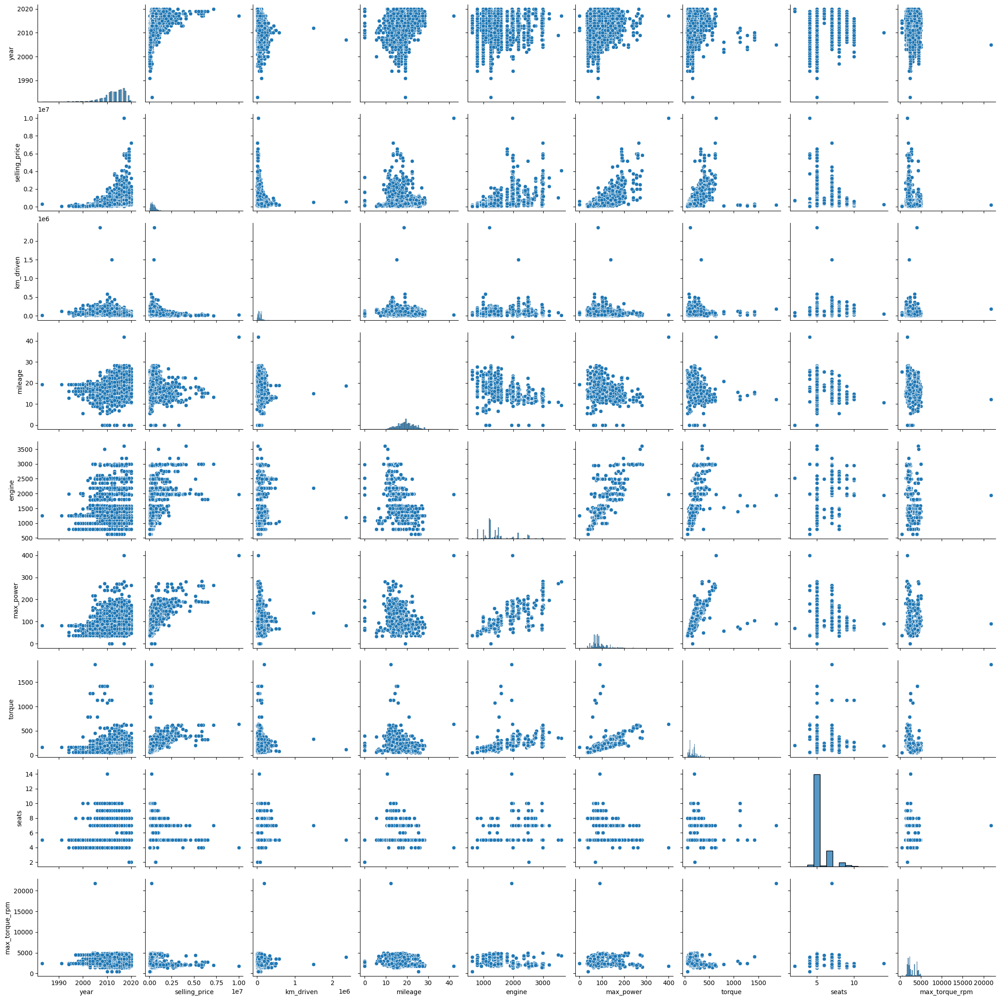

In [ ]:
sns.pairplot(df_train)

Можно предположить связь между целевой переменной и max_power, torque, распределение описывается прямой линией(линейная корреляция). Можно предположить, что между годом и целевой переменной имеется нелинейная корреляция.

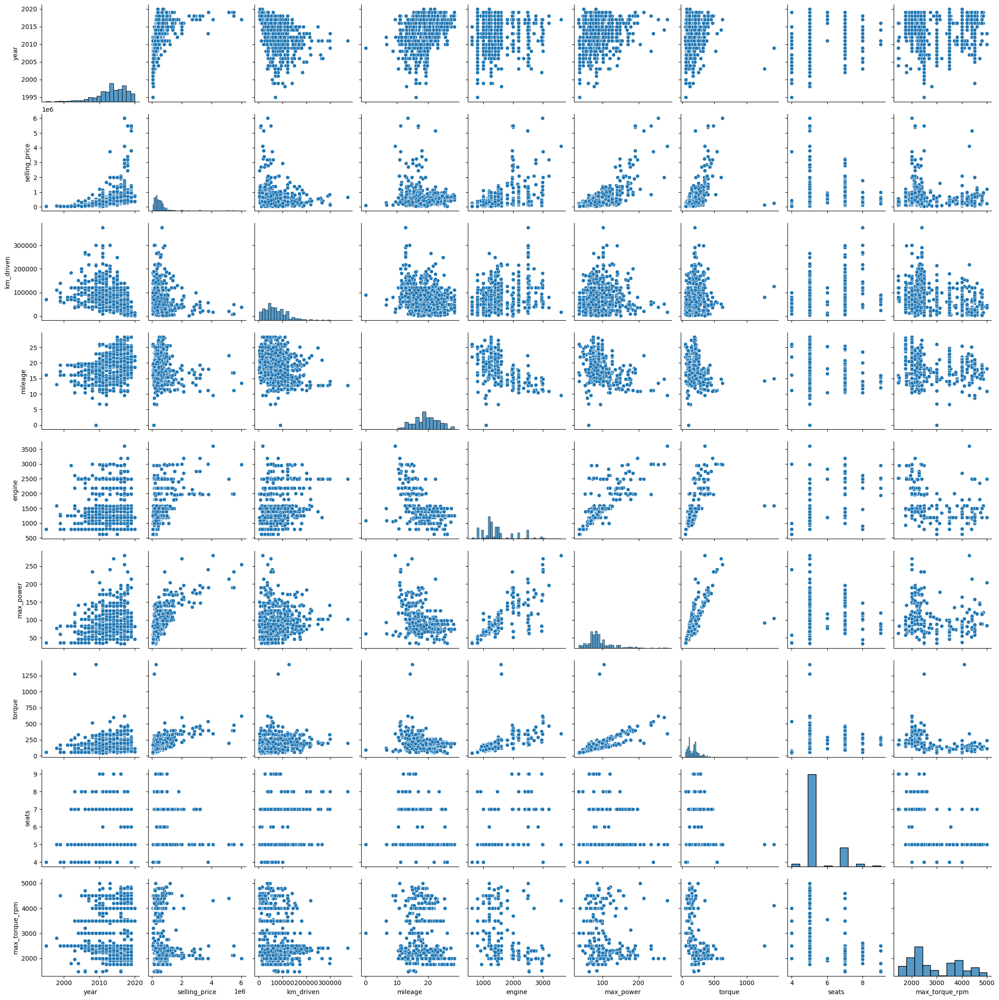

In [ ]:
sns.pairplot(df_test)

Значительных различий нет, в столбце max_torque_rpm появляется шум в тесте, которого нет в трейн

### **Задание 9 (0.5 балла)**

И так, вы выдвинули гипотезы о наличии связи. Теперь давайте оценим эту связь в числах.

**Задание:**
- [ ] Получите значения коэффициента корреляции Пирсона для тренировочного набора данных при помощи `pd.corr()`
- [ ] По полученным корреляциям постройте тепловую карту (`heatmap` из бибилотеки seaborn)

In [ ]:
df_cleaned = df_train.select_dtypes([int, float])

In [ ]:
correlation_matrix = df_cleaned.corr()
print(correlation_matrix)

                    year  selling_price  km_driven   mileage    engine  \
year            1.000000       0.427279  -0.368966  0.334901  0.002819   
selling_price   0.427279       1.000000  -0.164828 -0.086583  0.447672   
km_driven      -0.368966      -0.164828   1.000000 -0.179151  0.229766   
mileage         0.334901      -0.086583  -0.179151  1.000000 -0.535506   
engine          0.002819       0.447672   0.229766 -0.535506  1.000000   
max_power       0.157405       0.692874   0.024510 -0.334621  0.681262   
torque          0.052886       0.465611   0.112380 -0.202542  0.598172   
seats           0.041178       0.149953   0.192328 -0.428460  0.652182   
max_torque_rpm  0.033113      -0.174611  -0.228878 -0.117690 -0.376209   

                max_power    torque     seats  max_torque_rpm  
year             0.157405  0.052886  0.041178        0.033113  
selling_price    0.692874  0.465611  0.149953       -0.174611  
km_driven        0.024510  0.112380  0.192328       -0.228878  
mil

<Axes: >

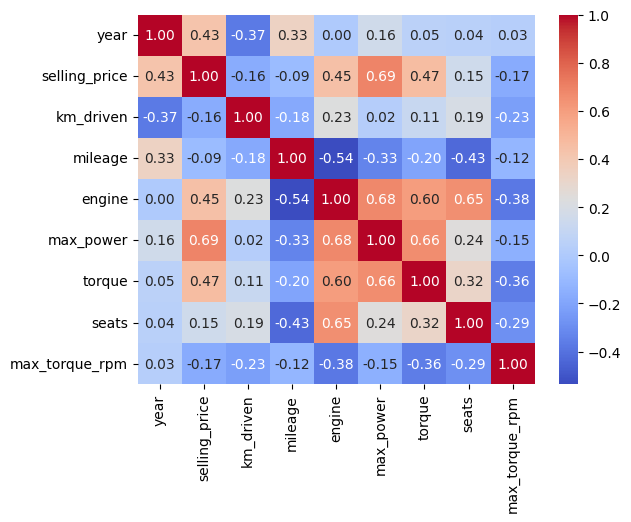

In [ ]:
sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap="coolwarm", cbar=True)

- [ ] Ответьте на вопросы:
 - Какие 2 признака наименее скоррелированы между собой?
 - Между какими наблюдается довольно сильная положительная линейная зависимость?
 - Правильно ли, опираясь на данные, утверждать, что чем меньше год, тем, скорее всего, больше километров проехала машина к дате продажи?

Наименее скоррелированы 'year' и 'engine'.
Между 'engine' и 'max_power', 'engine' и 'torque'.
Слабая корреляция, возможно машина простояла в гараже

### **Задание 10 (0.6 балла)**

По умолчанию `pd.corr` возвращает корреляцию Пирсона, говорящую о линейной взаимосвязи. Но зависимости существуют не только линейные! В этой задаче, попробуйте измерить другие способы вычисления корреляций.

- [ ] Реализуйте корреляцию Спирмена/Кендала (на выбор) без использования библиотек (можно пользоваться только `numpy`). Сравните результаты вычисления с библиотечной реализацией
- [ ]

Постройте матрицу корреляции [phik](https://pypi.org/project/phik/)
- [ ] Проинтерпретируйте результаты


In [ ]:
def kendall_tau_matrix(matrix):
    """
    Вычисление корреляции Кендела между столбцами матрицы.

    Параметры:
    matrix : array-like, shape (n_samples, n_features)
        Входная матрица, где строки — это наблюдения, а столбцы — переменные.

    Возвращает:
    tau_matrix : ndarray, shape (n_features, n_features)
        Матрица коэффициентов корреляции Кендела.
    """
    matrix = np.array(matrix)
    n_features = matrix.shape[1]
    tau_matrix = np.zeros((n_features, n_features))

    # Вычисляем корреляцию для каждой пары столбцов
    for i in range(n_features):
        for j in range(i, n_features):  # Используем симметрию
            tau = kendall_tau_correlation(matrix[:, i], matrix[:, j])
            tau_matrix[i, j] = tau
            tau_matrix[j, i] = tau  # Симметричное значение

    return tau_matrix

# Пример матрицы
data = np.array([
    [1, 2, 3],
    [4, 3, 1],
    [7, 6, 5],
    [8, 7, 9]
])

kendall_tau_result = kendall_tau_matrix(data)
kendall_tau_result


In [ ]:
phik_corr_matrix = df_train.phik_matrix()
phik_corr_matrix

interval columns not set, guessing: ['year', 'selling_price', 'km_driven', 'seats']


/usr/local/lib/python3.10/dist-packages/phik/data_quality.py:59: UserWarning: The number of unique values of variable name is large: 1924. Are you sure this is not an interval variable? Analysis for pairs of variables including name can be slow.
  warnings.warn(


,name,year,selling_price,km_driven,fuel,seller_type,transmission,owner,mileage,engine,max_power,torque,seats
name,1.000000,0.958596,0.997764,0.000000,1.000000,0.957095,1.000000,0.869509,0.999994,1.000000,0.999994,1.000000,0.999994
year,0.958596,1.000000,0.321340,0.088438,0.189642,0.387357,0.269321,0.434479,0.787805,0.714901,0.844680,0.871631,0.444354
selling_price,0.997764,0.321340,1.000000,0.000000,0.171446,0.540220,0.582424,0.557240,0.974921,0.895068,0.978227,0.989950,0.173821
km_driven,0.000000,0.088438,0.000000,1.000000,0.043054,0.023787,0.022121,0.091384,0.000000,0.226933,0.288439,0.196212,0.097521
fuel,1.000000,0.189642,0.171446,0.043054,1.000000,0.114782,0.076214,0.038599,0.993616,0.847804,0.965690,0.973510,0.448277
seller_type,0.957095,0.387357,0.540220,0.023787,0.114782,1.000000,0.228341,0.220036,0.804778,0.725050,0.780994,0.839559,0.104482
transmission,1.000000,0.269321,0.582424,0.022121,0.076214,0.228341,1.000000,0.138239,0.851333,0.795952,0.867952,0.895261,0.098342
owner,0.869509,0.434479,0.557240,0.091384,0.038599,0.220036,0.138239,1.000000,0.655193,0.529461,0.706111,0.858304,0.067920
mileage,0.999994,0.787805,0.974921,0.000000,0.993616,0.804778,0.851333,0.655193,1.000000,0.999185,0.999728,0.999833,0.965211
engine,1.000000,0.714901,0.895068,0.226933,0.847804,0.725050,0.795952,0.529461,0.999185,1.000000,0.999505,0.999949,0.863740


`Your answer here`

### **Дополнительные визуализации (бонус 0.2 балла)**

Если вам кажется, что мы не попросили вас нарисовать какие-то очень важные зависимости, нарисуйте их и поясните.

In [ ]:
# your code here

# **Часть 2 (1.7 балла) | Модель только на вещественных признаках**

В этой части вам предстоит обучить модель только на вещественных признаках. Почему только на них?

Чем больше признаковое пространство — чем сложнее модель. А чем модель проще — тем лучше для скорости работы и интерпретации признаков.

За задания этой части вы можете набрать 1.7 основных и 0.15 бонусных балла;

### **Задание 11 (0.05 балла)**

Разбейте данные на тренировочный и тестовый наборы. Перед разбиением создайте копию датафрейма, который будет хранить только вещественные признаки и используйте его (то есть категориальные столбцы (все, кроме seats) необходимо удалить).

В переменные y_train и y_test запишите значения целевых переменных.

In [ ]:
df_cleaned = df_train.select_dtypes([int, float])
df_cleaned.head(10)

,year,selling_price,km_driven,mileage,engine,max_power,torque,seats,max_torque_rpm
0,2014,450000,145500,23.40,1248,74.00,190.00,5,2000.0
1,2014,370000,120000,21.14,1498,103.52,250.00,5,2000.0
2,2010,225000,127000,23.00,1396,90.00,219.00,5,2250.0
3,2007,130000,120000,16.10,1298,88.20,112.00,5,4500.0
4,2017,440000,45000,20.14,1197,81.86,113.75,5,4000.0
5,2007,96000,175000,8.65,1061,57.50,76.00,5,4500.0
6,2001,45000,5000,16.10,796,37.00,59.00,4,2500.0
7,2011,350000,90000,23.59,1364,67.10,170.00,5,2100.0
8,2013,200000,169000,20.00,1399,68.10,160.00,5,2000.0
9,2014,500000,68000,19.01,1461,108.45,248.00,5,2250.0


In [ ]:
from sklearn.model_selection import train_test_split

In [ ]:
X = df_cleaned.drop('selling_price', axis = 1)
Y = df_cleaned['selling_price'].to_frame()
x_train,x_test,y_train, y_test = train_test_split(X,Y, test_size = 0.25, random_state = 42)
x_train.head(10)

,year,km_driven,mileage,engine,max_power,torque,seats,max_torque_rpm
2302,2017,56290,24.00,1186,73.97,190.24,5,2000.0
1468,2019,20000,18.00,1969,190.00,400.00,5,2000.0
5143,2017,60000,18.49,1493,100.00,240.00,7,2200.0
5014,2012,100000,18.50,1197,80.00,111.72,5,4000.0
6130,2018,5000,18.90,1197,81.86,113.75,5,4000.0
3143,2015,90000,22.54,1396,88.73,219.70,5,2125.0
6946,2010,60000,18.00,995,62.00,90.30,5,4200.0
107,2010,120000,19.16,1248,82.00,170.00,5,2400.0
29,2012,35000,14.00,796,35.00,59.78,5,3000.0
5634,2019,20000,22.37,2487,214.56,202.00,5,4400.0


In [ ]:
print(type(y_train))

<class 'pandas.core.frame.DataFrame'>


In [ ]:
#assert X_train.shape == (5840, 6)

In [ ]:
#assert X_test.shape == (1000, 6)

### **Задание 12. (0.2 балла)**

Построим нашу первую модель!
- [ ] Обучите классическую линейную регрессию с дефолтными параметрами. Посчтитайте $R^2$ и $MSE$ для трейна и для теста.
- [ ] Сделайте выводы по значениям метрик качества.

**Примечание:**

Здесь и далее $R^2$ и $MSE$ для трейна и для теста выводите везде, где требуется обучать модели, даже если в явном виде этого не просят. Иначе непонятно, как понять, насколько успешны наши эксперименты.

In [ ]:
y_train

In [ ]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score, mean_squared_error as MSE

lr1 = LinearRegression()
lr1.fit(x_train, y_train)
pred_test = lr1.predict(x_test)
MSE(y_test, pred_test)

255749146447.92038

In [ ]:
r2_score(y_test, pred_test)

0.607896596858871

### **Задание 13 (0.15 балла)**

- [ ] Реализуйте $R^2$ руками. Приведите формулу $R^2$ и объясните каждую компоненту метрики

In [ ]:
def r2_score_df(y_true_col, y_pred_col):
    """
    Вычисляет коэффициент детерминации (R^2) для данных в DataFrame.

    Параметры:
    df : pandas.DataFrame
        DataFrame, содержащий истинные и предсказанные значения.
    y_true_col : str
        Название столбца с истинными значениями.
    y_pred_col : str
        Название столбца с предсказанными значениями.

    Возвращает:
    float
        Значение R^2.
    """

    # Среднее значение истинных данных
    mean_y = y_true_col.mean()

    # Сумма квадратов ошибок
    ss_res = ((y_true_col - y_pred_col) ** 2).sum()

    # Полная сумма квадратов
    ss_tot = ((y_true_col - mean_y) ** 2).sum()

    # Коэффициент детерминации
    r2 = 1 - (ss_res / ss_tot)
    return r2

In [ ]:
k = r2_score_df(y_test, pred_test)
print(k)

selling_price    0.607897
dtype: float64


`Your answer here`

### **Бонус (0.15 балла)**

- [ ] Реализуйте [$\text{adjusted}-R^2$](https://en.wikipedia.org/wiki/Coefficient_of_determination).
- [ ] Объясните, когда применяется $\text{adjusted}-R^2$?

In [ ]:
def adjusted_r2_score(df_cleaned, y_true, y_pred, n_features):
    """
    Вычисляет скорректированный коэффициент детерминации (Adjusted R^2) для данных в DataFrame.

    Параметры:
    df : pandas.DataFrame
        DataFrame, содержащий истинные и предсказанные значения.
    y_true_col : str
        Название столбца с истинными значениями.
    y_pred_col : str
        Название столбца с предсказанными значениями.
    n_features : int
        Количество независимых переменных (предикторов) в модели.

    Возвращает:
    float
        Значение Adjusted R^2.
    """

    # Число наблюдений
    n = len(df_cleaned)

    # Вычисление обычного R^2
    mean_y = y_true.mean()
    ss_res = ((y_true - y_pred) ** 2).sum()
    ss_tot = ((y_true - mean_y) ** 2).sum()
    r2 = 1 - (ss_res / ss_tot)

    # Вычисление скорректированного R^2
    adjusted_r2 = 1 - ((1 - r2) * (n - 1) / (n - n_features - 1))
    return adjusted_r2

In [ ]:
p = adjusted_r2_score(df_cleaned,y_test, pred_test,8)
print(p)

selling_price    0.607448
dtype: float64


`Your answer here`

### **Задание 14 (0.05 балла)**

Всегда есть место совершенству. Поэтому давайте попробуем улучшить модель. При помощи стандартизации признаков.

- [ ] Стандартизируйте значения в тренировочных и тестовых данных. Стандартизатор **обучайте только на `train`**.

In [ ]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
scaler.fit(x_train)
x_train_scaler = scaler.transform(x_train)
x_test_scaler = scaler.transform(x_test)

lr2 = LinearRegression()
lr2.fit(x_train_scaler, y_train)
pred_test_2 = lr2.predict(x_test_scaler)
r2_score(y_test, pred_test_2)

0.6078965968588694

### **Задание 15 (0.1 балла)**

Хотя стандартизация не помогла сильно прибавить в качестве она открыла возможность интерпретировать важность признаков в модели. Правило интерпретации такое:

Чем больше коэффициент $\beta_i$ по модулю, тем важнее признак.

**Ответьте на вопрос:**

- [ ] Какой признак оказался наиболее информативным в предсказании цены?

In [ ]:
lr2.coef_

array([[ 168964.15273598, -103013.13543345,   -6363.65188725,
          19782.1077322 ,  563134.07433004,  -13052.26081608,
         -83783.39338292,  -82169.36466876]])

### **Задание 16 (0.25 балла)**

Попробуем улучшить нашу модель с помощью применения регуляризации. Для этого воспльзуемся `Lasso` регрессией.  Кроме того, попробуйте использовать её теоретическое свойство отбора признаков, за счет зануления незначимых коэффициентов.

**Задание:**

- [ ] Обучите Lasso регрессию на тренировочном наборе данных с нормализованными признаками. Оцените её качество
- [ ] Проверьте, занулила ли L1-регуляризация с параметрами по умолчанию какие-нибудь веса? Предположите почему.

In [ ]:
from sklearn.linear_model import Lasso

lr3 = Lasso()
lr3.fit(x_train_scaler, y_train)
pred_test = lr3.predict(x_test_scaler)
r2_score(y_test, pred_test)

0.6078969670221517

In [ ]:
lr3.coef_

array([ 4.15343778e+04, -1.99975044e+00, -1.56363647e+03,  3.98632531e+01,
        1.59039666e+04, -1.19758670e+02, -8.81811346e+04, -8.32522757e+01])

### **Задание 17. Финальный рывок (0.4 балла)**

До этого мы с вами использовали `train` для обучения и `test` для прогнозирования. Но у нас есть ещё одна задача — подобрать оптимальные параметры модели. Для этого используем кросс-валидацию, описанную на семинарах.

Кроме того, выжмем максимум из модификаций регрессии. Построим `ElasticNet`. И сделаем всё по порядку.

**Ваша задача 1:**

- [ ] Перебором по сетке (c 10-ю фолдами) подберите оптимальные параметры для Lasso-регрессии. Вам пригодится класс [GridSearchCV](https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.GridSearchCV.html).
- [ ] Ответьте на вопросы:
 - Сколько грид-сёрчу пришлось обучать моделей?
 - Что значит каждый параметр `param_grid`, который вы заполняли для `GridSearch`? Опишите каждый
 - Какой коэффициент регуляризации у лучшей из перебранных моделей? Занулились ли какие-нибудь из весов при такой регуляризации?

In [ ]:
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import Lasso
from sklearn.datasets import make_regression  # Для создания тестовых данных

# Сгенерируем примерные данные для примера
X, y = make_regression(n_samples=100, n_features=5, noise=0.1)

# Определим параметры для поиска
param_grid = {
    'alpha': [0.01, 0.1, 1, 10, 100],  # Попробуем разные значения параметра alpha
    'max_iter': [1000, 2000, 3000],  # Число итераций
}

# Создадим модель Lasso
lasso_model = Lasso()

# Используем GridSearchCV
grid_search = GridSearchCV(estimator=lasso_model, param_grid=param_grid, cv=10, scoring='neg_mean_squared_error')

# Выполним поиск
grid_search.fit(X, y)

# Результаты
print("Лучшие параметры:", grid_search.best_params_)
print("Наилучшее значение MSE:", -grid_search.best_score_

**Ваша задача 2:**

- [ ] Перебором по сетке (c 10-ю фолдами) подберите оптимальные параметры для [ElasticNet](https://scikit-learn.org/stable/modules/generated/sklearn.linear_model.ElasticNet.html) регрессии.
- [ ] Ответьте на вопрос:
 - Сколько грид-сёрчу пришлось обучать моделей?
 - Какие гиперпараметры соответствуют лучшей (по выбранной метрике качества) из перебранных моделей?

### **Задание 18 (0.35 балла)**

И так, вы обучили все варианты регуляризаций, доступные в sklearn, но не все, что мы обсудили на занятии! И следующее задание о забытой - $L0$ регуляризации.


**Ваша задача:**>
- [ ] Реализуйте модель с $L0$-регуляризаицей.
- [ ] Обучите модель на данных и проанализируйте результат, экспериментируя с коэффициенитом регуляризации
- [ ] Проанализируйте результаты обучения

**Важно:**

Вопреки тому, что L0 не реализована в стандартных пакетах, концепция данной регуляризации не является мертвой. Она может встречаться в [статьях](https://arxiv.org/abs/1712.01312) и экспериментах.



In [ ]:
# your code here

# **Часть 3 (0.5 балла) | Добавляем категориальные фичи**

Попробуем для улучшения модели дать ей больше признаков. Добавим категориальные фичи.

За эту часть можно набрать 0.5 основных балла.



### **Задание 19 (0.1 балла)**

Проанализируйте столбец `name`. Очевидно, что эта переменная является категориальной, однако категорий в ней много.

- [ ] Предобработайте столбец `name`, чтобы избежать его удаления

In [ ]:
df_train['name'] = df_train['name'].str.lower()

In [ ]:
df_train['brand'] = df_train['name'].str.split().str[0]

In [ ]:
df_train

,name,year,selling_price,km_driven,fuel,seller_type,transmission,owner,mileage,engine,max_power,torque,seats,brand
0,maruti swift dzire vdi,2014,450000,145500,Diesel,Individual,Manual,First Owner,23.4 kmpl,1248 CC,74 bhp,190Nm@ 2000rpm,5.0,maruti
1,skoda rapid 1.5 tdi ambition,2014,370000,120000,Diesel,Individual,Manual,Second Owner,21.14 kmpl,1498 CC,103.52 bhp,250Nm@ 1500-2500rpm,5.0,skoda
2,hyundai i20 sportz diesel,2010,225000,127000,Diesel,Individual,Manual,First Owner,23.0 kmpl,1396 CC,90 bhp,22.4 kgm at 1750-2750rpm,5.0,hyundai
3,maruti swift vxi bsiii,2007,130000,120000,Petrol,Individual,Manual,First Owner,16.1 kmpl,1298 CC,88.2 bhp,"11.5@ 4,500(kgm@ rpm)",5.0,maruti
4,hyundai xcent 1.2 vtvt e plus,2017,440000,45000,Petrol,Individual,Manual,First Owner,20.14 kmpl,1197 CC,81.86 bhp,113.75nm@ 4000rpm,5.0,hyundai
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6994,hyundai i20 magna,2013,320000,110000,Petrol,Individual,Manual,First Owner,18.5 kmpl,1197 CC,82.85 bhp,113.7Nm@ 4000rpm,5.0,hyundai
6995,hyundai verna crdi sx,2007,135000,119000,Diesel,Individual,Manual,Fourth & Above Owner,16.8 kmpl,1493 CC,110 bhp,"24@ 1,900-2,750(kgm@ rpm)",5.0,hyundai
6996,maruti swift dzire zdi,2009,382000,120000,Diesel,Individual,Manual,First Owner,19.3 kmpl,1248 CC,73.9 bhp,190Nm@ 2000rpm,5.0,maruti
6997,tata indigo cr4,2013,290000,25000,Diesel,Individual,Manual,First Owner,23.57 kmpl,1396 CC,70 bhp,140Nm@ 1800-3000rpm,5.0,tata


In [ ]:
assert X_train_cat.shape == (5840, 11)

In [ ]:
X_train_cat.describe(include='object')

### **Задание 20 (0.1 балла)**

- [ ] Закодируйте категориалльные фичи и ``seats`` методом OneHot-кодирования.

In [ ]:
from sklearn.preprocessing import OneHotEncoder # или можно использовать get_dummies из библиотеки pandas
import pandas as pd

categorical_columns = ['brand', 'model', 'seats']

df_encoded = pd.get_dummies(df_train, columns=categorical_columns)

# your code here

### **Задание 21 (0.2 балла)**

OHE — базовый алгоритм преобразования категориальных признаков, но и с ним нужно быть аккуратными.

**Ответьте на вопросы:**


* Как корректно работать с OHE преобразованием?
* Почему мы удаляем один столбец?
* Пусть из $n$ признаков мы получили $n-1$ столбец, из которых $k < n -1$ оказались не важными по весам модели. Корректно ли их удалить?

Необходимо убедиться, что ограниченное количество уникальных категорий. Иначе можно сильно увеличить размерность данных.

Столбец мы удаляем, чтобы не было линейной зависимости между столбцами.

Признак может быть скоррелирован с другим признаком, лучше не удалять

### **Задание 22 (0.1 балла)**
Повторим то, что делали на прошлом шаге для моделей на вещественных признаках, однако теперь с моделью `Ridge`.


**Ваша задача:**
- [ ] Переберите параметр регуляризации `alpha` для гребневой (ridge) регрессии с помощью класса `GridSearchCV` В качестве параметров при объявлении GridSearchCV кроме модели укажите метрику качества $R^2$. Кроссвалидируйтесь по 10-ти фолдам.
- [ ] Ответье на вопрос: Удалось ли улучшить качество прогнозов?

In [ ]:
from sklearn.linear_model import Ridge
from sklearn.model_selection import GridSearchCV

ridge = Ridge()

# Параметры для поиска
param_grid = {'alpha': [0.1, 1, 10, 100, 1000]}

grid_search = GridSearchCV(
    estimator=ridge,
    param_grid=param_grid,
    scoring='r2',          # Метрика качества: R2
    cv=10,                 # Кросс-валидация: 10 фолдов            # Использование всех процессоров
)

grid_search.fit(X, y)

# Вывод лучших параметров и результата
print("Лучшее значение alpha:", grid_search.best_params_['alpha'])
print("Лучшее значение R2:", grid_search.best_score_)

# **Часть 4 - бонусная (1 балл) | Feature Engineering**

В этой части домашнего задания вам предлагается проявить свою креативность для улучшения прогноза модели. Любые другие модели, кроме различных форм линейной (или полиномиальной) регресси, использовать запрещается. А значит, придется работать с признаками

**Что можно попробовать сделать?** (каждый пункт по 0.4 балла, но не больше 2-х баллов в сумме)

1.   *Сгенерировать новые признаки на основе уже существующих:*
    * посчитать произведения // частные признаков (кажется, что посчитать число "лошадей" на литр объема может быть полезно);
    * имеет смысл обратить внимание на визуализации в части с EDA (к примеру, зависимость цены от года выглядит квадратичной, а не линейной; значит, квадрат года нам, скорее всего, принесет больше пользы)

2.   *Добыть новые признаки:*
    * имеем название автомобиля, которое никак не используем (можно спарсить инфу о классе автомобиля или каких-то специфических опциях)
    * можно добавить пороговые признаки вроде "владелец третий или больше" и объединить признаки в некоторые осмысленные правила, например "первый или второй владелец и продавец официальный дилер" (подбирать пороги удобно по диаграммам рассеяния)

3.   *Поработать с уже имеющимися:*
    * далеко не факт, что заполнить пропуск медианой было лучшей идеей (как минимум, можно добавить dummy-столбец для модели, сигнализирующий, что раньше на месте медианы был пропуск -- там где он был, конечно); попробуйте другие способы филлинга;
    * мы не анализировали, есть ли в данных выбросы => никак выбросы не обрабатывали; наиболее простым и, тем не менее, довольно полезным вариантом нахождения выбросов могут послужить boxplot'ы для каждого столбца; что делать с выбросами думайте сами :) -- вариантов довольно много
    * мы толком не смотрели на таргет сам по себе; в нем тоже могут быть неожиданности -- стоит хотя бы проверить
    * можно заметить, что некоторые признаки распределены совсем не нормально; возможно их стоит отлогарифмировать

И так далее...

Feel Free to Try!

In [ ]:
# your code here

# **Часть 4. | Бизнесовая (0.5 балла)**

### **Задание 23 (0.25 балла)**

В мире бизнеса очень важно давать оценку качества модели понятную бизнесу, поэтому иногда заказчики приходят с кастомными метриками. Попробуем сделать такую для нашей задачи.

**Описание метрики:**

Среди всех предсказанных цен на авто нужно посчитать долю прогнозов, отличающихся от реальных цен на эти авто не более чем на 10% (в одну или другую сторону)

**Ваша задача:**

- [ ] Реализуйте метрику `business_metric`
- [ ] Посчитайте метрику для всех обученных моделей и определеите, какаю лучше всего решает задачу бизнеса

In [ ]:
def business_metrics(y_true, y_pred):
  k = 0
  for i in range(len(y_true)):
    if abs(y_true[i] - y_pred[i]) <= 0.1:
      k += 1

0.6666666666666666


### **Задание 24 (0.25 балла)**

Но у бизнеса не всегда есть идеи и иногда задача на выбор метрики делегируется вам.

**Задание:**

- [ ] Придумайте и реализуйте другую кастомную метрику с учетом того, что модель не должна сильно ошибаться в прогнозе, но недопрогноз для модели, согласно мнению бизнеса, хуже, чем перепрогноз.
- [ ] Посчитайте метрику для всех обученных моделей и определеите, какаю лучше всего решает задачу бизнеса



In [ ]:
import numpy as np

def weighted_relative_error(actual, predicted, alpha=2.0, beta=1.0):
    actual = np.array(actual)
    predicted = np.array(predicted)

    errors = np.abs(actual - predicted) / actual
    weights = np.where(predicted < actual, alpha, beta)
    weighted_error = np.mean(errors * weights)
    return weighted_error

# Пример использования:
actual_prices = [20000, 30000, 25000, 40000]
predicted_prices = [18000, 31000, 24000, 39000]

# Задаем веса: штраф за недопрогноз больше
alpha = 2.0  # Вес для недопрогноза
beta = 1.0   # Вес для перепрогноза

weighted_error_result = weighted_relative_error(actual_prices, predicted_prices, alpha, beta)
print("Взвешенная относительная ошибка:", weighted_error_result)


# **Часть 5 (3 балла) | Реализация сервиса на FastAPI**

### **Задание 25**

Cделайте с помощью FastAPI сервис, который с точки зрения пользователя реализует две функции:

1. на вход в формате json подаются признаки одного объекта, на выходе сервис выдает предсказанную стоимость машины
2. на вход подается csv-файл с признаками тестовых объектов, на выходе получаем файл с +1 столбцом - предсказаниями на этих объектах

С точки зрения реализации это означает следующее:
- средствами pydantic должен быть описан класс базового объекта
- класс с коллецией объектов
- метод post, который получает на вход один объект описанного класса
- метод post, который получает на вход коллекцию объектов описанного класса

Шаблон для сервисной части дан ниже. Код необходимо дополнить и оформить в виде отдельного .py-файла.

In [ ]:
from fastapi import FastAPI
from pydantic import BaseModel
from typing import List

app = FastAPI()


class Item(BaseModel):
    name: str
    year: int
    selling_price: int
    km_driven: int
    fuel: str
    seller_type: str
    transmission: str
    owner: str
    mileage: str
    engine: str
    max_power: str
    torque: str
    seats: float


class Items(BaseModel):
    objects: List[Item]


@app.post("/predict_item")
def predict_item(item: Item) -> float:
    return ...


@app.post("/predict_items")
def predict_items(items: List[Item]) -> List[float]:
    return ...

Протестируйте сервис на корректность работы и приложите скриншоты (см. ниже).

# **Часть 6 (1 балл) | Оформление результатов**

### **Задание 26**

**Результаты вашей работы** необходимо разместить в своем Гитхабе. Под результатами понимаем следующее:
* ``.ipynb``-ноутбук со всеми проведёнными вами экспериментами (output'ы ячеек, разумеется, сохранить)
* ``.py``-файл с реализацией сервиса
* ``.pickle``-файл с сохранёнными весами модели, коэффициентами скейлинга и прочими числовыми значениями, которые могут понадобиться для инференса
* ``.md``-файл с выводами про проделанной вами работе:
    * что было сделано
    * с какими результатами
    * что дало наибольший буст в качестве
    * что сделать не вышло и почему (это нормально, даже хорошо😀)

**За что могут быть сняты баллы в этом пункте:**
* за отсутствие ``.pickle``-файла с весами использованной модели
* за недостаточную аналитику в ``.md``-файле
* за оформление и логику кода (в определённом смысле это тоже элемент оформления решения)

**Как будет выглядет проверка всего домашнего задания?**
1. Ассистент проходит по ссылке на (**открытый**) репозиторий из Энитаска
2. Смотрит ``readme.md``:
    * пожалуйста, приложите в него же скрины работы вашего сервиса -- собирать ваши проекты довольно времязатратно, но хочется убедиться, что всё работает
    * можете в md-файл приложить ссылку на screencast с демонстрацией

3. Просматривает ноутбук с DS частью
4. Заглядывает в код сервиса
5. Хвалит

# **Часть Благодарственная**

Надеемся, вы честно проделали все пункты, а не просто пролистали досюда. Потому что здесь награда за старания. Пожалуйста, не стоит награждать себя до того, как закончите работать над домашкой.

<details>
<summary><b>Что-то приятное</b></summary>

**Напоминаем, что нашем курсе действует система кото-бонусов** 🐈

На фото по ссылке — сэр кот кого-то из команды курса (преподаватель, помощник преподавателя, ассистенты).

Предлагаем вам угадать — чей это товарищ!

[Первый кот](https://ibb.co/Kz1ZRWj)

</details>